<a href="https://colab.research.google.com/github/felitrisnanto/Hotel-Cancellation-Analysis/blob/main/hotel_booking_cancellation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Hotel Booking Cancellation Prediction**

Data Science Challenge Dibimbing

by : Felicia Trisnanto

# Background



# Objective

1. Create a machine learning model to predict whether a customer will cancel hotel booking reservation or not.
2. Analyze hotel booking reservation data to identify factors that lead customer to cancel their booking reservation.
This findings can help hotel company to make business decisions and strategies to reduce the number of booking cancellation and potentially increase their revenue.

# Install and Load Libraries

In [ ]:
!pip install scikit-plot
!pip install dataprep
!pip install pycaret

In [ ]:
# Library for data manipulation
import pandas as pd
import numpy as np

# Set options for pandas
pd.set_option('display.max_columns', 35)
pd.set_option('max_colwidth', 350)

import warnings
warnings.filterwarnings('ignore')

# Library for data visualization
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from dataprep.eda import *

# Library for machine learning
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from pycaret.classification import *

# Library for evaluation model metric
from sklearn.metrics import f1_score, accuracy_score


# Load Dataset

In [ ]:
# Load dataset to `hotel` dataframe
hotel = pd.read_csv('train.csv')

# Data Understanding

In [ ]:
# Show first 5 rows
hotel.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
0,"Crystal Cove, Barbados Barbados",0,8,2019,January,2,10,0,4,2,0.0,0,BB,ITA,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,314.0,NaN,0,Transient,38.40,0,0,Check-Out,2019-01-14,1
1,"Greensboro Courtyard Greensboro, NC",1,524,2018,December,51,15,0,2,2,0.0,0,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,Non Refund,1.0,NaN,0,Transient,62.80,0,0,Canceled,2017-10-21,2
2,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",1,175,2019,May,20,19,1,2,2,0.0,0,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,Non Refund,12.0,NaN,0,Transient,110.00,0,0,Canceled,2018-11-25,3
3,"Courtyard by Marriott Aberdeen Airport Aberdeen, United Kingdom",0,0,2018,October,43,17,1,0,1,0.0,0,BB,NaN,Corporate,Corporate,0,0,0,A,A,0,No Deposit,NaN,200.0,0,Transient,45.00,0,0,Check-Out,2018-10-18,4
4,"W New York – Union Square New York, NY",1,33,2017,September,39,26,2,3,2,0.0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,16.0,NaN,0,Transient,57.92,0,1,Canceled,2017-08-24,5


In [ ]:
# Show data structure
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83293 entries, 0 to 83292
Data columns (total 33 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           83293 non-null  object 
 1   is_canceled                     83293 non-null  int64  
 2   lead_time                       83293 non-null  int64  
 3   arrival_date_year               83293 non-null  int64  
 4   arrival_date_month              83293 non-null  object 
 5   arrival_date_week_number        83293 non-null  int64  
 6   arrival_date_day_of_month       83293 non-null  int64  
 7   stays_in_weekend_nights         83293 non-null  int64  
 8   stays_in_week_nights            83293 non-null  int64  
 9   adults                          83293 non-null  int64  
 10  children                        83290 non-null  float64
 11  babies                          83293 non-null  int64  
 12  meal                            

Observation :
* There are **83293 data** and  **33 columns** in this dataset.
* 12 columns have object or string data type. These columns need to be processed in data cleaning section.
* 21 columns have numeric data type. 17 of them are integer and 4 of them are float.
* From basic information of the data, `children` column has float data type, we need to change this into integer as number of children is a discrete data not continuous.
* `reservation_status_date` has object data type, we need to convert this column into datetime data type.
* There are few column has different non-null value. Therefore, we need to check for missing value in this dataset.


In [ ]:
# Convert `reservation_status_date` from object to datetime datatype
hotel['reservation_status_date'] = pd.to_datetime(hotel['reservation_status_date'], format='%Y-%m-%d')

# Show new data structure
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83293 entries, 0 to 83292
Data columns (total 33 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   hotel                           83293 non-null  object        
 1   is_canceled                     83293 non-null  int64         
 2   lead_time                       83293 non-null  int64         
 3   arrival_date_year               83293 non-null  int64         
 4   arrival_date_month              83293 non-null  object        
 5   arrival_date_week_number        83293 non-null  int64         
 6   arrival_date_day_of_month       83293 non-null  int64         
 7   stays_in_weekend_nights         83293 non-null  int64         
 8   stays_in_week_nights            83293 non-null  int64         
 9   adults                          83293 non-null  int64         
 10  children                        83290 non-null  float64       
 11  ba

In [ ]:
hotel.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
0,"Crystal Cove, Barbados Barbados",0,8,2019,January,2,10,0,4,2,0.0,0,BB,ITA,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,314.0,NaN,0,Transient,38.40,0,0,Check-Out,2019-01-14,1
1,"Greensboro Courtyard Greensboro, NC",1,524,2018,December,51,15,0,2,2,0.0,0,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,Non Refund,1.0,NaN,0,Transient,62.80,0,0,Canceled,2017-10-21,2
2,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",1,175,2019,May,20,19,1,2,2,0.0,0,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,Non Refund,12.0,NaN,0,Transient,110.00,0,0,Canceled,2018-11-25,3
3,"Courtyard by Marriott Aberdeen Airport Aberdeen, United Kingdom",0,0,2018,October,43,17,1,0,1,0.0,0,BB,NaN,Corporate,Corporate,0,0,0,A,A,0,No Deposit,NaN,200.0,0,Transient,45.00,0,0,Check-Out,2018-10-18,4
4,"W New York – Union Square New York, NY",1,33,2017,September,39,26,2,3,2,0.0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,16.0,NaN,0,Transient,57.92,0,1,Canceled,2017-08-24,5


# Data Cleaning

## Handling Duplicated Data

In [ ]:
print("Number of duplicated data: ", hotel.duplicated().sum())

Number of duplicated data:  0


There are no duplicated data in this dataset, so we can continue to the next step which is checking for missing value

## Handling Missing Value

In [ ]:
# Function to find ratio of missing value
def find_ratio_na(df):
  '''
    total_row = total of row data
    count_na = total of missing value
    ratio_na = ratio of missing value
  '''

  total_row = df.shape[0]
  count_na = df.isnull().sum()
  ratio_na = ((count_na/total_row)*100).round(2)
  return ratio_na

In [ ]:
# Create dataframe to check ratio and total missing value for each column
hotel_na = pd.DataFrame({'column': hotel.columns,
                         'total_missing_val': hotel.isnull().sum(),
                         'ratio_missing_val': find_ratio_na(hotel)})

# Reset index
hotel_na = hotel_na.reset_index(drop=True)

# Sort hotel_na based on total_missing_val
hotel_na.sort_values('total_missing_val', inplace=True, ascending=False)

# Show total and ratio missing value that are not 0
hotel_na[hotel_na['total_missing_val']!=0]

,column,total_missing_val,ratio_missing_val
24,company,78559,94.32
23,agent,11404,13.69
13,country,346,0.42
10,children,3,0.00


Observation:
* Out of 33 columns, 4 columns have null or missing value that is, `company`, `agent`, `country`, and `children`.
* `company` has 94.32% missing value. Hence, we may need to remove this column because the missing value ratio is more than 80%.
* `agent`, `country`, and `children` has missing value less than 80%.  We need further analysis to decide how to handle missing value in these columns.

### 1. Handling `company`

In [ ]:
# Drop `company` column
hotel.drop('company', axis=1, inplace=True)

# Show data structure after drop `company`
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83293 entries, 0 to 83292
Data columns (total 32 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   hotel                           83293 non-null  object        
 1   is_canceled                     83293 non-null  int64         
 2   lead_time                       83293 non-null  int64         
 3   arrival_date_year               83293 non-null  int64         
 4   arrival_date_month              83293 non-null  object        
 5   arrival_date_week_number        83293 non-null  int64         
 6   arrival_date_day_of_month       83293 non-null  int64         
 7   stays_in_weekend_nights         83293 non-null  int64         
 8   stays_in_week_nights            83293 non-null  int64         
 9   adults                          83293 non-null  int64         
 10  children                        83290 non-null  float64       
 11  ba

### 2. Handling `agent`

In [ ]:
# Explore `agent` column

# Check for unique value of `agent`
agent_unique_val = hotel['agent'].unique()
print('Total unique value of "agent": ', len(agent_unique_val))
print(np.sort(agent_unique_val))

Total unique value of "agent":  321
[  1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.  14.
  15.  16.  17.  19.  20.  21.  22.  23.  24.  26.  27.  28.  29.  30.
  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  44.  45.
  47.  50.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  63.  64.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  77.  78.  79.  81.
  82.  83.  85.  86.  87.  88.  89.  90.  91.  92.  94.  95.  96.  98.
  99. 103. 104. 105. 106. 107. 110. 111. 112. 114. 115. 118. 119. 121.
 122. 126. 127. 128. 129. 132. 133. 134. 135. 138. 139. 141. 142. 143.
 144. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 162. 163. 165. 167. 168. 170. 171. 173. 174. 175. 177. 179. 180.
 181. 182. 183. 184. 185. 187. 191. 192. 193. 195. 196. 197. 201. 205.
 208. 210. 211. 214. 215. 216. 219. 220. 223. 227. 229. 232. 234. 235.
 236. 240. 241. 242. 243. 244. 245. 247. 248. 249. 250. 251. 252. 253.
 254. 256. 257. 258. 261. 262. 265. 267. 

Observation:
* From the results, it can be assumed that `agent` column is a column of agent id.
* We can fill missing value with 0.
* Since `agent` column has float data type, we need to convert it into integer.


In [ ]:
# # Create new column 'is_agent'
# hotel['is_agent']= hotel['agent'].apply(lambda x: 1 if pd.notna(x) else 0)

# # Compare 'is_agent' and 'agent' to check whether the mapping is right
# hotel[['agent', 'is_agent']]

In [ ]:
# # Drop `agent` column
# hotel.drop('agent', axis=1, inplace=True)

# # Show data structure after drop `agent`
# hotel.info()

In [ ]:
# Replace NA value to 0 for `agent` column
hotel['agent'] = hotel['agent'].fillna(0)

# Convert agent from float to int
hotel['agent'] = hotel['agent'].astype(int)

# Check for missing value on `agent` column
hotel['agent'].isnull().sum()

0

### 3. Handling `country`

In [ ]:
# Explore `country` column

# Check for unique value of `country`
country_unique_val = hotel['country'].unique()
print('Total unique value of "country": ', len(country_unique_val))
print(country_unique_val)

Total unique value of "country":  166
['ITA' 'PRT' nan 'BEL' 'DNK' 'GBR' 'IRL' 'ESP' 'DEU' 'RUS' 'NOR' 'CN'
 'USA' 'AUS' 'CHE' 'NLD' 'FRA' 'CHN' 'TUR' 'BRA' 'KOR' 'PLW' 'ZAF' 'POL'
 'HUN' 'MOZ' 'HKG' 'IND' 'LUX' 'MAR' 'FIN' 'ISR' 'DZA' 'SWE' 'CYP' 'GRC'
 'OMN' 'AUT' 'JPN' 'SVN' 'AGO' 'MCO' 'ARG' 'MYS' 'LVA' 'LTU' 'MEX' 'STP'
 'SAU' 'MRT' 'NGA' 'SVK' 'COL' 'THA' 'ROU' 'SUR' 'BGR' 'EST' 'ARE' 'VEN'
 'SGP' 'BIH' 'CHL' 'HRV' 'URY' 'TWN' 'ALB' 'GNB' 'BLR' 'SRB' 'GEO' 'CUB'
 'CZE' 'ZMB' 'ZWE' 'BHR' 'KEN' 'IRN' 'PER' 'ISL' 'TJK' 'LBN' 'NZL' 'MAC'
 'SEN' 'PHL' 'JOR' 'AND' 'DJI' 'KAZ' 'GTM' 'IRQ' 'GAB' 'LBY' 'MDV' 'TUN'
 'EGY' 'UKR' 'GIB' 'PRY' 'KWT' 'KNA' 'IDN' 'CPV' 'GLP' 'COM' 'AZE' 'UGA'
 'MKD' 'LAO' 'SYC' 'MLT' 'PAK' 'QAT' 'AIA' 'FJI' 'DOM' 'ECU' 'PRI' 'CRI'
 'CAF' 'MMR' 'ARM' 'SLV' 'TZA' 'HND' 'BEN' 'KHM' 'FRO' 'BFA' 'RWA' 'BOL'
 'VNM' 'BRB' 'TMP' 'BGD' 'MUS' 'NPL' 'ABW' 'ETH' 'CMR' 'PAN' 'CIV' 'MYT'
 'JAM' 'SYR' 'UZB' 'UMI' 'LKA' 'JEY' 'ASM' 'CYM' 'NIC' 'KIR' 'GHA' 'SDN'
 'MNE' 'DMA' 'MW

In [ ]:
# Filter hotel name and country which `country` is not null
hotel[['hotel','country']][~hotel['country'].isna()]

,hotel,country
0,"Crystal Cove, Barbados Barbados",ITA
1,"Greensboro Courtyard Greensboro, NC",PRT
2,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",PRT
4,"W New York – Union Square New York, NY",PRT
5,"Hotel Maria Cristina, San Sebastian San Sebastian, Spain",PRT
...,...,...
83288,"Crystal Cove, Barbados Barbados",FRA
83289,"Berlin Marriott Hotel Berlin, Germany",CHE
83290,"The Ritz-Carlton, Tokyo Tokyo, Japan",IRL
83291,"Colony Club, Barbados Barbados",DEU


Observation:
* From the table, we found out that `country` column is customer's origin country not hotel's location.
* Instead of remove missing value for 'country', we can impute the missing value to 'unknown'

In [ ]:
# Replace NA value to "unknown" for `country` column
hotel['country'] = hotel['country'].fillna("Unknown")

# Check if there still a missing value on `country` column
hotel['country'].isnull().sum()

0

### 4. Handling `children`

In [ ]:
# Filter hotel data where `children` is NA
hotel[hotel['children'].isna()]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,NaN,0,BB,PRT,Undefined,Undefined,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593
24197,"Protea Hotel Fire & Ice! by Marriott Johannesburg Melrose Arch Johannesburg, South Africa",1,8,2017,August,33,13,2,5,2,NaN,0,BB,PRT,Online TA,Undefined,0,0,0,B,B,0,No Deposit,9,0,Transient-Party,76.5,0,1,Canceled,2017-08-09,24198
75373,"Colony Club, Barbados Barbados",1,1,2017,August,32,5,0,2,2,NaN,0,BB,PRT,Direct,Undefined,0,0,0,B,B,0,No Deposit,14,0,Transient-Party,12.0,0,1,Canceled,2017-08-04,75374


Since there are only 3 missing values in `children` column, we can replace the missing value using mode.

In [ ]:
# Find mode of `children`
children_mode = hotel['children'].mode()[0]
print('mode of "children": ', children_mode)

mode of "children":  0.0


Most of customers who booked a hotel didn't bring or didn't have a child, we can fill missing value with 0

In [ ]:
# Replace NA value to 0 for `children` column
hotel['children'] = hotel['children'].fillna(0)

# Convert children from float to int (number of children is discrete not continuous)
hotel['children'] = hotel['children'].astype(int)

# Check if there still a missing value on `children` column
hotel['children'].isnull().sum()

0

In [ ]:
# Check after replacement
hotel[hotel['bookingID'] == 6593]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,0,0,BB,PRT,Undefined,Undefined,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593


In [ ]:
# Check if there are any missing value on the dataset
hotel.isnull().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
arrival_date_week_number          0
arrival_date_day_of_month         0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
babies                            0
meal                              0
country                           0
market_segment                    0
distribution_channel              0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
reserved_room_type                0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
agent                             0
days_in_waiting_list              0
customer_type                     0
adr                               0
required_car_parking_spaces 

## Descriptive Statistic

In [ ]:
#Separate categorical and numerical data
cat_features = hotel.select_dtypes(include=['object']).columns.tolist()
num_features = hotel.select_dtypes(include=np.number).columns.tolist()

print(f'categorical features: {len(cat_features)} \n{cat_features} \n')
print(f'numerical features: {len(num_features)} \n{num_features} \n')




categorical features: 11 
['hotel', 'arrival_date_month', 'meal', 'country', 'market_segment', 'distribution_channel', 'reserved_room_type', 'assigned_room_type', 'deposit_type', 'customer_type', 'reservation_status'] 

numerical features: 20 
['is_canceled', 'lead_time', 'arrival_date_year', 'arrival_date_week_number', 'arrival_date_day_of_month', 'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children', 'babies', 'is_repeated_guest', 'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes', 'agent', 'days_in_waiting_list', 'adr', 'required_car_parking_spaces', 'total_of_special_requests', 'bookingID'] 



### Categorical features

In [ ]:
hotel[cat_features].describe().T

,count,unique,top,freq
hotel,83293,64,"Renaissance New York Times Square Hotel New York, NY",1373
arrival_date_month,83293,12,August,9643
meal,83293,5,BB,64424
country,83293,166,PRT,33952
market_segment,83293,8,Online TA,39445
distribution_channel,83293,5,TA/TO,68368
reserved_room_type,83293,10,A,60062
assigned_room_type,83293,11,A,51702
deposit_type,83293,3,No Deposit,72979
customer_type,83293,4,Transient,62535


In [ ]:
# Display value and count value for each categorical column
for column in cat_features:
  print("Feature", column, ":")
  print(hotel[column].value_counts())
  print("="*70)

Feature hotel :
Renaissance New York Times Square Hotel New York, NY                           1373
Sacramento Airport Natomas Courtyard Sacramento, CA                            1372
Las Vegas Marriott Las Vegas, NV                                               1371
Crystal Cove, Barbados Barbados                                                1360
Protea Hotel by Marriott Midrand Midrand, South Africa                         1352
                                                                               ... 
W New York – Union Square New York, NY                                         1250
The House, Barbados Barbados                                                   1249
Sheraton Grand Rio Hotel & Resort Rio de Janeiro, Brazil                       1249
African Pride Melrose Arch, Autograph Collection Johannesburg, South Africa    1246
Residence Inn Rio de Janeiro Barra da Tijuca Barra da Tijuca, Brazil           1246
Name: hotel, Length: 64, dtype: int64
Feature arrival_date_m

### Numerical features

In [ ]:
hotel[num_features].describe().T

,count,mean,std,min,25%,50%,75%,max
is_canceled,83293.0,0.369503,0.482673,0.0,0.00,0.0,1.0,1.0
lead_time,83293.0,103.914230,106.874124,0.0,18.00,69.0,160.0,737.0
arrival_date_year,83293.0,2018.156808,0.706656,2017.0,2018.00,2018.0,2019.0,2019.0
arrival_date_week_number,83293.0,27.164023,13.623752,1.0,16.00,27.0,38.0,53.0
arrival_date_day_of_month,83293.0,15.786116,8.775931,1.0,8.00,16.0,23.0,31.0
stays_in_weekend_nights,83293.0,0.930390,1.004196,0.0,0.00,1.0,2.0,19.0
stays_in_week_nights,83293.0,2.503812,1.924511,0.0,1.00,2.0,3.0,50.0
adults,83293.0,1.854466,0.606139,0.0,2.00,2.0,2.0,55.0
children,83293.0,0.103610,0.398815,0.0,0.00,0.0,0.0,10.0
babies,83293.0,0.008032,0.100641,0.0,0.00,0.0,0.0,10.0


Observation:
* It can be observed that this data consist of hotel reservations from 2017 to 2019.
* There are some anomalies in `children` and `babies` columns where the maximum is 10.  This is really interesting because usually people will book villa as their accomodation for large groups and families.
* On `adults` column, the maximum number of adults in one booking id is 55. This is interesting because normally people didn't book hotel room for more than 4 adults unless it's a tour agency that needs to book multiple rooms for a group tour.
* There are someone who has cancelled booking for 26 times.
* There are someone who made booking changes for 21 times.
* There are at least one booking id with status 'in waiting list' for 391 days.

## Handling outlier

In [ ]:
# Create function to remove outliers
def remove_outlier(df, col):

  # Calculate IQR
  Q1 = df[col].quantile(0.25)
  Q3 = df[col].quantile(0.75)
  IQR = Q3 - Q1

  # Declare upper and lower limit
  lower = Q1 - 1.5*IQR
  upper = Q3 + 1.5*IQR

  # Remove outlier
  new_df = df[~((df[col] > upper) | (df[col] < lower))]

  return new_df

### Feature `lead_time`

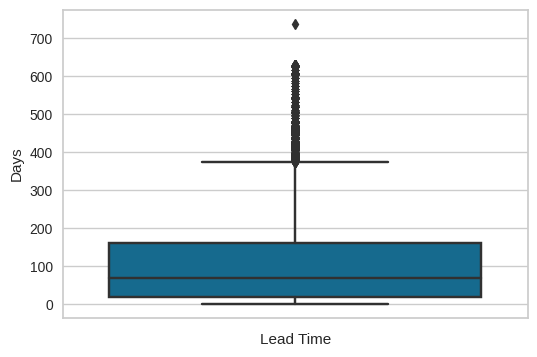

In [ ]:
# Set plot size
plt.figure(figsize=(6, 4))

# Boxplot for `lead_time`
sns.boxplot(y='lead_time', data=hotel)

plt.xlabel('Lead Time')
plt.ylabel('Days')

plt.show()

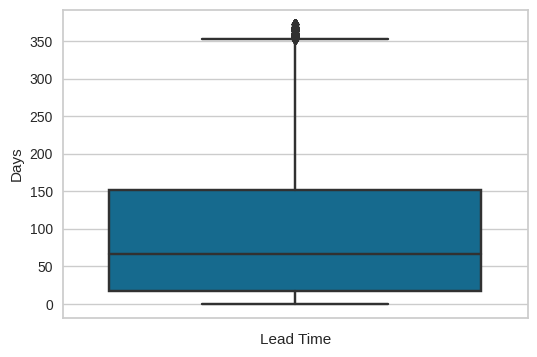

In [ ]:
# Remove outlier for 'lead_time'
hotel = remove_outlier(hotel,'lead_time')

# Set plot size
plt.figure(figsize=(6, 4))

# Boxplot for `lead_time`
sns.boxplot(y='lead_time', data=hotel)

plt.xlabel('Lead Time')
plt.ylabel('Days')

plt.show()

In [ ]:
# Show new data shape
hotel.shape

(81181, 32)

### Feature `adr`

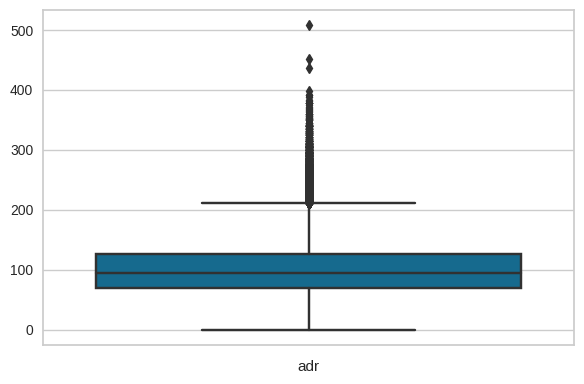

In [ ]:
# Set plot size
plt.figure(figsize=(6, 4))

# Boxplot for `adr`
sns.boxplot(y='adr', data=hotel)

plt.xlabel('adr')
plt.ylabel(None)

plt.tight_layout()
plt.show()

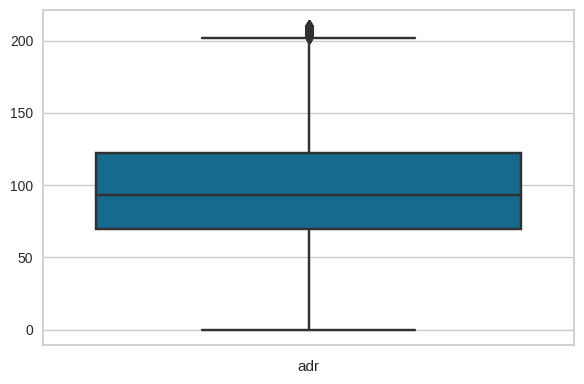

In [ ]:
# Remove outlier for 'adr'
hotel = remove_outlier(hotel,'adr')

# Set plot size
plt.figure(figsize=(6, 4))

# Boxplot for `adr`
sns.boxplot(y='adr', data=hotel)

plt.xlabel('adr')
plt.ylabel(None)

plt.tight_layout()
plt.show()

In [ ]:
# Show new data shape
hotel.shape

(78516, 32)

In [ ]:
# Reset index
hotel.reset_index(drop=True)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
0,"Crystal Cove, Barbados Barbados",0,8,2019,January,2,10,0,4,2,0,0,BB,ITA,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,314,0,Transient,38.40,0,0,Check-Out,2019-01-14,1
1,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",1,175,2019,May,20,19,1,2,2,0,0,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,Non Refund,12,0,Transient,110.00,0,0,Canceled,2018-11-25,3
2,"Courtyard by Marriott Aberdeen Airport Aberdeen, United Kingdom",0,0,2018,October,43,17,1,0,1,0,0,BB,Unknown,Corporate,Corporate,0,0,0,A,A,0,No Deposit,0,0,Transient,45.00,0,0,Check-Out,2018-10-18,4
3,"W New York – Union Square New York, NY",1,33,2017,September,39,26,2,3,2,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,16,0,Transient,57.92,0,1,Canceled,2017-08-24,5
4,"W New York – Times Square New York, NY",0,205,2019,June,24,13,0,4,2,0,0,BB,BEL,Online TA,TA/TO,0,0,0,D,D,0,No Deposit,9,0,Transient,150.75,0,2,Check-Out,2019-06-17,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78511,"Crystal Cove, Barbados Barbados",0,4,2018,October,44,25,0,2,2,1,0,BB,FRA,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,9,0,Transient,169.00,1,1,Check-Out,2018-10-27,83289
78512,"Berlin Marriott Hotel Berlin, Germany",0,30,2017,September,38,14,1,3,2,0,0,BB,CHE,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,9,0,Transient,94.50,0,2,Check-Out,2017-09-18,83290
78513,"The Ritz-Carlton, Tokyo Tokyo, Japan",0,165,2019,June,25,21,4,10,2,0,0,BB,IRL,Direct,Direct,0,0,0,E,E,0,No Deposit,0,0,Transient,123.50,0,1,Check-Out,2019-07-05,83291
78514,"Colony Club, Barbados Barbados",0,180,2018,July,32,31,2,4,2,1,0,BB,DEU,Online TA,TA/TO,0,0,0,A,D,0,No Deposit,9,0,Transient,122.25,0,1,Check-Out,2018-08-06,83292


## Feature Engineering

### Feature `meal`

In [ ]:
# Explore `meal` column

# Check for unique value of `meal`
meal_unique_val = hotel['meal'].unique()
print('Total unique value of "meal": ', len(meal_unique_val))

# Check meal value count
print(hotel['meal'].value_counts())

Total unique value of "meal":  5
BB           61095
HB            8764
SC            7397
Undefined      786
FB             474
Name: meal, dtype: int64


Notes:
1. BB = Bed and Breakfast
2. HB = Half Board (Bed + Breakfast + Dinner)
3. FB = Full Board (Bed + Breakfast + Lunch + Dinner)
4. SC = Self-Catering

Observation:

> We can observed that there are 'Undefined' value (which is missing value) on `meal` column. This value may indicates that the guest did not reserve a room with a meal plan. Hence, we can replace 'Undefined' value with 'SC'.

In [ ]:
hotel[hotel['meal']=='Undefined'].head(2)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
173,"Renaissance Hamburg Hotel Hamburg, Germany",0,40,2019,January,3,16,1,2,1,0,0,Undefined,PRT,Groups,Direct,0,0,0,A,A,0,No Deposit,0,0,Transient-Party,55.0,0,0,Check-Out,2019-01-19,174
291,"Protea Hotel Fire & Ice! by Marriott Cape Town Cape Town, South Africa",0,112,2018,February,7,12,0,2,3,0,0,Undefined,ESP,Groups,TA/TO,0,0,0,A,C,1,No Deposit,134,0,Transient-Party,94.5,0,0,Check-Out,2018-02-14,292


In [ ]:
# Replace 'undefined' to 'SC' in column `meal`
hotel['meal'] = hotel['meal'].str.replace('Undefined', 'SC')

# Check replacement
hotel[hotel['bookingID'] == 174]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
173,"Renaissance Hamburg Hotel Hamburg, Germany",0,40,2019,January,3,16,1,2,1,0,0,SC,PRT,Groups,Direct,0,0,0,A,A,0,No Deposit,0,0,Transient-Party,55.0,0,0,Check-Out,2019-01-19,174


### Feature `market_segment`

In [ ]:
# Explore `market_segment` column

# Check for unique value of `market_segment`
market_segment_unique_val = hotel['market_segment'].unique()
print('Total unique value of "market_segment": ', len(market_segment_unique_val))

# Check market_segment value count
print(hotel['market_segment'].value_counts())

Total unique value of "market_segment":  8
Online TA        37552
Offline TA/TO    16161
Groups           12305
Direct            8112
Corporate         3699
Complementary      524
Aviation           162
Undefined            1
Name: market_segment, dtype: int64


Observation:

> We can observed that there is a 'Undefined' value (which is a missing value) on `market_segment` column. Hence, we can replace 'Undefined' value with mode.

In [ ]:
hotel[hotel['market_segment'] == 'Undefined']

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,0,0,BB,PRT,Undefined,Undefined,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593


In [ ]:
# Replace missing value with mode in column 'market_segment'
hotel['market_segment'] = hotel['market_segment'].str.replace('Undefined', hotel['market_segment'].mode()[0])

# Check replacement
hotel[hotel['bookingID'] == 6593]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,0,0,BB,PRT,Online TA,Undefined,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593


### Feature `distribution_channel`

In [ ]:
# Explore `distribution_channel` column

# Check for unique value of `distribution_channel`
distribution_channel_unique_val = hotel['distribution_channel'].unique()
print('Total unique value of "distribution_channel": ', len(distribution_channel_unique_val))

# Check distribution_channel value count
print(hotel['distribution_channel'].value_counts())

Total unique value of "distribution_channel":  5
TA/TO        64332
Direct        9470
Corporate     4577
GDS            133
Undefined        4
Name: distribution_channel, dtype: int64


Observation:

> We can observed that there are 'Undefined' values (which is a missing value) on `distribution_channel` column. Hence, we can replace 'Undefined' value with mode.

In [ ]:
hotel[hotel['distribution_channel'] == 'Undefined']

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,0,0,BB,PRT,Online TA,Undefined,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593
24197,"Protea Hotel Fire & Ice! by Marriott Johannesburg Melrose Arch Johannesburg, South Africa",1,8,2017,August,33,13,2,5,2,0,0,BB,PRT,Online TA,Undefined,0,0,0,B,B,0,No Deposit,9,0,Transient-Party,76.5,0,1,Canceled,2017-08-09,24198
59800,"Renaissance Santo Domingo Jaragua Hotel & Casino Santo Domingo, Dominican Republic",0,103,2017,July,28,5,2,3,2,1,0,HB,PRT,Direct,Undefined,0,0,0,A,A,0,No Deposit,0,0,Transient,112.7,1,2,Check-Out,2017-07-10,59801
75373,"Colony Club, Barbados Barbados",1,1,2017,August,32,5,0,2,2,0,0,BB,PRT,Direct,Undefined,0,0,0,B,B,0,No Deposit,14,0,Transient-Party,12.0,0,1,Canceled,2017-08-04,75374


In [ ]:
# Replace missing value with mode in column 'distribution_channel'
hotel['distribution_channel'] = hotel['distribution_channel'].str.replace('Undefined', hotel['distribution_channel'].mode()[0])

# Check replacement
hotel[hotel['bookingID'] == 6593]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
6592,"Renaissance Hamburg Hotel Hamburg, Germany",1,1,2017,August,32,5,0,2,3,0,0,BB,PRT,Online TA,TA/TO,0,0,0,B,B,0,No Deposit,0,0,Transient-Party,18.0,0,2,Canceled,2017-08-04,6593


### Feature `children`

In [ ]:
# Explore `children` column

# Check for unique value of `children`
children_unique_val = hotel['children'].unique()
print('Total unique value of "children": ', len(children_unique_val))

# Check children value count
print(hotel['children'].value_counts())

Total unique value of "children":  5
0     73705
1      2988
2      1800
3        22
10        1
Name: children, dtype: int64


Observation:
* From the result, most of the number of children is around 0 to 3 children, but the maximum is 10! (It is surprising as usually people would book a villa not a hotel if they book accommodation for more than 4 people).


In [ ]:
# Check the anomaly
hotel[hotel['children'] == 10]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
71636,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",1,55,2017,July,29,12,4,10,2,10,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,D,D,2,No Deposit,8,0,Contract,133.16,0,1,No-Show,2017-07-12,71637


Observation:
* We can see that the entry seems to be legit, except for the number of children. It could be wrongly entered by the customer where they intended to enter 1 but instead entered 10.

In [ ]:
# Replace value from 10 to 1
hotel['children'] = hotel['children'].replace(10, 1)

# Check replacement
hotel[hotel['bookingID'] == 71637]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
71636,"The Westin Peachtree Plaza, Atlanta Atlanta, GA",1,55,2017,July,29,12,4,10,2,1,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,D,D,2,No Deposit,8,0,Contract,133.16,0,1,No-Show,2017-07-12,71637


### Feature `babies`

In [ ]:
# Explore `babies` column

# Check for unique value of `babies`
babies_unique_val = hotel['babies'].unique()
print('Total unique value of "babies": ', len(babies_unique_val))

# Check babies value count
print(hotel['babies'].value_counts())

Total unique value of "babies":  5
0     77921
1       585
2         8
10        1
9         1
Name: babies, dtype: int64


Observation:
* From the result, most of the number of babies is around 0 to 2 babies, but the data shows there are 9-10 babies! (It is surprising as usually people would book a villa not a hotel if they book accommodation for more than 4 people).


In [ ]:
# Check the anomaly
hotel[hotel['babies'] > 2]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
71964,"Waves, Barbados Barbados",0,37,2018,January,3,12,0,2,2,0,10,BB,PRT,Online TA,TA/TO,0,0,0,D,D,1,No Deposit,9,0,Transient,84.45,0,1,Check-Out,2018-01-14,71965
72741,"Des Moines West/Clive Courtyard Clive, IA",0,11,2017,October,42,11,2,1,1,0,9,BB,GBR,Corporate,Corporate,0,0,0,A,B,1,No Deposit,95,0,Transient-Party,95.00,0,0,Check-Out,2017-10-14,72742


Observation:
* We can see that the entry seems to be legit, except for the number of babies. It could be wrongly entered by the customer or simple noise. For now, we enter this to 0.

In [ ]:
# Replace value from 9 to 0
hotel['babies'] = hotel['babies'].replace(9, 0)

# Replace value from 10 to 0
hotel['babies'] = hotel['babies'].replace(10, 0)

# Check new data after replacement
hotel[(hotel['bookingID'] == 71965)	| (hotel['bookingID'] == 72742)]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
71964,"Waves, Barbados Barbados",0,37,2018,January,3,12,0,2,2,0,0,BB,PRT,Online TA,TA/TO,0,0,0,D,D,1,No Deposit,9,0,Transient,84.45,0,1,Check-Out,2018-01-14,71965
72741,"Des Moines West/Clive Courtyard Clive, IA",0,11,2017,October,42,11,2,1,1,0,0,BB,GBR,Corporate,Corporate,0,0,0,A,B,1,No Deposit,95,0,Transient-Party,95.00,0,0,Check-Out,2017-10-14,72742


### Feature `adults`

In [ ]:
# Explore `adults` column

# Check for unique value of `adults`
adults_unique_val = hotel['adults'].unique()
print('Total unique value of "adults": ', len(adults_unique_val))

# Check adults value count
print(hotel['adults'].value_counts())

Total unique value of "adults":  14
2     58438
1     15956
3      3802
0       285
4        22
26        5
50        1
10        1
27        1
40        1
55        1
5         1
6         1
20        1
Name: adults, dtype: int64


Observation:
* From the result, most of the number of adults is around 0 to 4 adults, but the data shows some people book up to 55 adults!


In [ ]:
# Check the anomaly
hotel[hotel['adults'] > 4]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
4242,"Las Vegas Marriott Las Vegas, NV",1,336,2017,September,37,7,1,2,50,0,0,BB,PRT,Direct,Direct,0,0,0,A,A,0,No Deposit,0,0,Group,0.0,0,0,Canceled,2017-01-18,4243
12668,"Indianapolis Airport Courtyard Indianapolis, IN",1,334,2017,October,42,12,2,5,10,0,0,BB,PRT,Direct,Direct,0,0,0,E,E,0,No Deposit,0,0,Group,0.0,0,0,Canceled,2017-01-02,12669
28122,"Residence Inn Las Vegas Convention Center Las Vegas, NV",1,354,2017,September,39,26,2,5,26,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,96,0,Group,0.0,0,0,Canceled,2017-01-02,28123
28470,"Sacramento Airport Natomas Courtyard Sacramento, CA",1,349,2017,September,39,21,1,3,27,0,0,HB,PRT,Direct,Direct,0,0,0,A,A,0,No Deposit,0,0,Group,0.0,0,0,Canceled,2017-01-02,28471
38011,"Frankfurt Marriott Hotel Frankfurt, Germany",1,304,2017,September,36,3,0,3,40,0,0,BB,PRT,Direct,Direct,0,0,0,A,A,0,No Deposit,0,0,Group,0.0,0,0,Canceled,2017-01-02,38012
39003,"Spokane Downtown at the Convention Center Courtyard Spokane, WA",1,333,2017,September,36,5,2,5,26,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,96,0,Group,0.0,0,0,Canceled,2017-01-02,39004
39547,"Grosvenor House, A JW Marriott Hotel London, United Kingdom",1,347,2017,September,38,19,2,5,26,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,96,0,Group,0.0,0,0,Canceled,2017-01-02,39548
55758,"The Ritz-Carlton, Tokyo Tokyo, Japan",1,340,2017,September,37,12,2,5,26,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,96,0,Group,0.0,0,0,Canceled,2017-01-02,55759
65582,"Hotel Alfonso XIII, a Luxury Collection Hotel, Seville Seville, Spain",1,338,2017,October,41,4,2,0,55,0,0,HB,PRT,Direct,Direct,0,0,0,A,A,0,No Deposit,0,0,Group,0.0,0,0,Canceled,2017-01-02,65583
68235,"Indianapolis Airport Courtyard Indianapolis, IN",1,361,2017,October,40,3,2,5,26,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,96,0,Group,0.0,0,0,Canceled,2017-01-02,68236


Observation:
* We can see that when the number of adults > 4, all of them doesn't have children or babies, and have `reservation_status` = cancelled. It could be someone wrong entered and they decided to cancel the book. To avoid bias, it is better to drop these rows.

In [ ]:
# Drop rows where adults > 4
hotel = hotel[~(hotel['adults'] > 4)].reset_index(drop=True)

# Show new data shape
hotel.shape


(78503, 32)

### Feature `adults`, `children`, `babies`

A booking id must consist at least one guest. Therefore, we must filter the data that have 0 adult, 0 child, and 0 baby.

In [ ]:
filter = (hotel.adults == 0) & (hotel.children == 0) & (hotel.babies == 0)

# Show total reservation with zero guest
print("total reservation with zero(0) guest: ", len(hotel[filter]))

# Show reservation with zero guest
hotel[filter]

total reservation with zero(0) guest:  126


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,bookingID
1289,"Sheraton Grand Rio Hotel & Resort Rio de Janeiro, Brazil",0,37,2018,November,47,17,1,3,0,0,0,SC,BRA,Online TA,TA/TO,0,0,0,A,K,1,No Deposit,9,0,Transient,97.40,1,1,Check-Out,2018-11-21,1378
1623,"Protea Hotel by Marriott Cape Town Sea Point Cape Town, South Africa",0,31,2018,December,53,27,2,8,0,0,0,BB,PRT,Direct,Direct,0,0,0,D,D,3,No Deposit,0,0,Transient,28.00,1,0,Check-Out,2019-01-06,1727
1872,"Sheraton Mexico City Maria Isabel Hotel Mexico City, Mexico",0,0,2019,February,9,27,0,0,0,0,0,BB,PRT,Online TA,TA/TO,1,0,0,A,K,0,No Deposit,85,0,Transient,0.00,0,0,Check-Out,2019-02-27,1992
1916,"Baton Rouge Acadian Centre/LSU Area Courtyard Baton Rouge, LA",0,0,2017,August,33,10,9,20,0,0,0,SC,PRT,Online TA,Direct,0,0,0,E,K,20,No Deposit,0,0,Transient,0.00,0,0,Check-Out,2017-09-08,2037
2267,"Orlando Airport Courtyard Orlando, FL",0,0,2017,December,52,24,0,0,0,0,0,BB,FRA,Offline TA/TO,TA/TO,1,0,0,D,K,0,No Deposit,28,0,Transient,0.00,0,1,Check-Out,2017-12-24,2402
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76027,"Courtyard by Marriott Toulouse Airport Toulouse, France",1,1,2017,September,37,6,2,0,0,0,0,SC,PRT,Groups,TA/TO,0,0,0,A,A,0,No Deposit,1,0,Transient-Party,0.00,0,0,Canceled,2017-09-05,80659
76803,"Courtyard by Marriott Toulouse Airport Toulouse, France",1,0,2019,August,32,11,0,0,0,0,0,SC,PRT,Online TA,TA/TO,0,0,0,P,P,0,No Deposit,0,0,Transient,0.00,0,0,Canceled,2019-08-11,81487
77297,"Protea Hotel Fire & Ice! by Marriott Cape Town Cape Town, South Africa",1,173,2018,April,15,8,2,3,0,0,0,BB,PRT,Offline TA/TO,TA/TO,0,0,0,A,A,0,No Deposit,21,0,Transient-Party,0.00,0,0,Canceled,2018-03-29,82013
77934,"Tamarind, Barbados Barbados",0,177,2018,December,53,30,2,5,0,0,0,BB,PRT,Direct,Direct,0,0,0,E,K,2,No Deposit,0,0,Transient,1.29,0,2,Check-Out,2019-01-06,82682


In [ ]:
# Delete filter data
hotel = hotel[~filter].reset_index(drop=True)

# Show data dimension (row, column) after drop filter
hotel.shape

(78377, 32)

### Add Features

In [ ]:
# total_guests = num. of adults + num. of children + num. of babies
hotel['total_guests'] = hotel['adults'] + hotel['children'] + hotel['babies']

# `total_stay_nights` = total stay in weekday + total stay in weekend
hotel['total_stay_nights'] = hotel['stays_in_week_nights'] + hotel['stays_in_weekend_nights']

# Add feature `is_assigned_change` which describe whether the room assigned is the same as reserved or not
hotel['is_assigned_change'] = hotel.apply(lambda row: 1 if row['assigned_room_type'] != row['reserved_room_type'] else 0, axis=1)

# Add feature `guest_type` based on `total_guests`
'''
    "single" = 1 guest
    "couple" = 2 guests
    "group"  = more than 2 guests
'''
hotel['guest_type'] = hotel['total_guests'].apply(lambda x: "single" if x == 1 else ("couple" if x == 2 else "group"))



In [ ]:
# Drop column
drop_column = ['adults','children','babies','stays_in_week_nights', 'stays_in_weekend_nights']
hotel = hotel.drop(drop_column, axis=1)

In [ ]:
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78377 entries, 0 to 78376
Data columns (total 31 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   hotel                           78377 non-null  object        
 1   is_canceled                     78377 non-null  int64         
 2   lead_time                       78377 non-null  int64         
 3   arrival_date_year               78377 non-null  int64         
 4   arrival_date_month              78377 non-null  object        
 5   arrival_date_week_number        78377 non-null  int64         
 6   arrival_date_day_of_month       78377 non-null  int64         
 7   meal                            78377 non-null  object        
 8   country                         78377 non-null  object        
 9   market_segment                  78377 non-null  object        
 10  distribution_channel            78377 non-null  object        
 11  is

# Exploratory Data Analysis (EDA)

In [ ]:
hotel.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'bookingID',
       'total_guests', 'total_stay_nights', 'is_assigned_change',
       'guest_type'],
      dtype='object')

## Univariate Analysis

In [ ]:
#Separate categorical and numerical data
cat_features = hotel.select_dtypes(include=['object']).columns.tolist()
num_features = hotel.select_dtypes(include=np.number).columns.tolist()

print(f'categorical features: {len(cat_features)} \n{cat_features} \n')
print(f'numerical features: {len(num_features)} \n{num_features} \n')


categorical features: 12 
['hotel', 'arrival_date_month', 'meal', 'country', 'market_segment', 'distribution_channel', 'reserved_room_type', 'assigned_room_type', 'deposit_type', 'customer_type', 'reservation_status', 'guest_type'] 

numerical features: 18 
['is_canceled', 'lead_time', 'arrival_date_year', 'arrival_date_week_number', 'arrival_date_day_of_month', 'is_repeated_guest', 'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes', 'agent', 'days_in_waiting_list', 'adr', 'required_car_parking_spaces', 'total_of_special_requests', 'bookingID', 'total_guests', 'total_stay_nights', 'is_assigned_change'] 



hotel


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



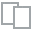
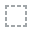
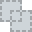
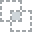
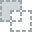
...
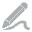
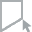
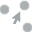
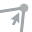
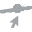

arrival_date_month


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



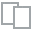
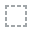
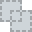
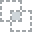
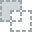
...
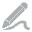
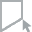
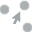
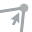
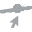

meal


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



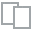
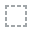
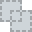
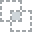
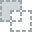
...
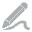
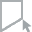
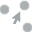
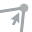
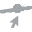

country


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



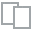
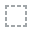
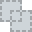
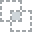
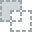
...
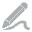
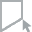
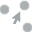
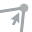
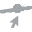

market_segment


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



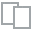
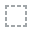
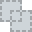
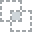
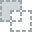
...
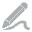
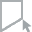
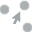
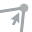
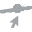

distribution_channel


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



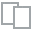
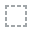
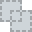
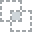
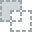
...
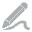
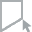
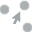
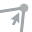
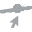

reserved_room_type


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



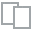
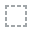
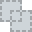
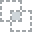
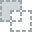
...
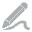
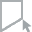
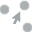
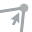
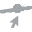

assigned_room_type


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



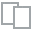
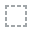
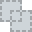
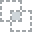
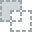
...
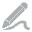
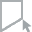
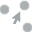
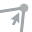
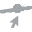

deposit_type


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



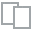
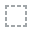
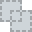
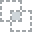
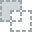
...
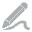
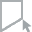
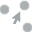
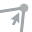
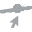

customer_type


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



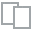
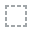
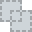
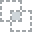
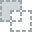
...
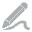
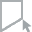
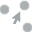
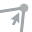
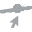

reservation_status


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



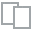
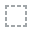
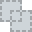
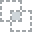
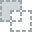
...
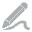
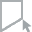
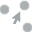
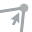
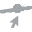

guest_type


The plot will not show in a notebook environment, please try 'show_browser' if you want to open it in browser



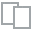
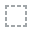
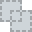
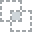
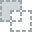
...
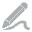
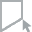
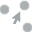
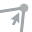
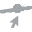

In [ ]:
for feature in cat_features:
  print(feature)
  plot(hotel,feature).show()

In [ ]:
for feature in num_features:
  plot(hotel,feature).show()

### Target Distribution (Cancellation Status)

In [ ]:
# 'total_cancel' represent number of bookings by cancellation status
total_cancel = hotel['is_canceled'].value_counts()
total_cancel

0    50054
1    28323
Name: is_canceled, dtype: int64

In [ ]:
# 'percentage_cancel' represent proportion of number of booking by cancellation status
percentage_cancel = hotel['is_canceled'].value_counts(normalize=True).mul(100).round(2)
percentage_cancel

0    63.86
1    36.14
Name: is_canceled, dtype: float64

Text(0.5, 1.0, 'Percentage of Hotel Booking Cancellation')

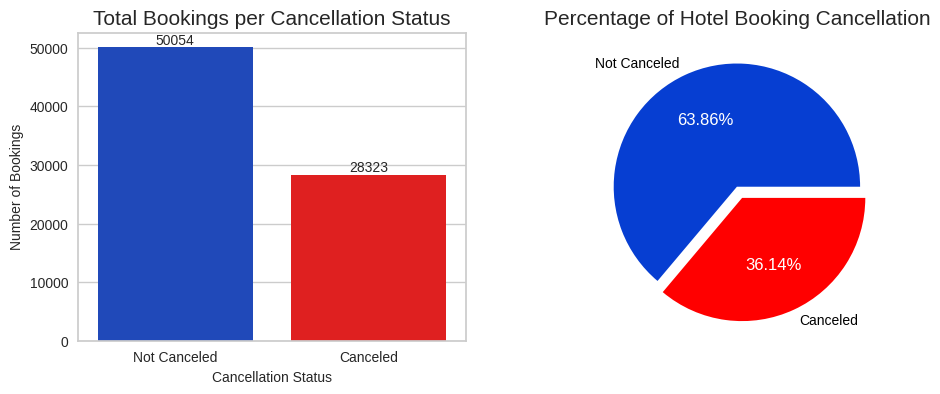

In [ ]:
# Set Label
label = ['Not Canceled', 'Canceled']

# Set plot size
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(11, 4))

# Draw bar chart for cancellation status
sns.barplot(x=label, y=total_cancel,
            palette = {'Not Canceled':'#063ed2','Canceled': 'red'},
            ax=ax[0])

# Set title and label for bar chart
ax[0].set_title('Total Bookings per Cancellation Status', fontsize = 15)
ax[0].set_xlabel('Cancellation Status', fontsize=10)
ax[0].set_ylabel('Number of Bookings', fontsize=10)
ax[0].bar_label(ax[0].containers[0], fontsize = 10)

# Set explode
explode = [0, 0.1]

# Draw pie chart for cancellation status
wedges, texts, autotexts = ax[1].pie(percentage_cancel, labels=label, colors=['#063ed2','red'],
          explode=explode, autopct='%.2f%%', textprops={'color':'white'})

# Set cancellation status label color from white to black
for text in texts:
  text.set_color('black')

# Set title for pie chart
ax[1].set_title('Percentage of Hotel Booking Cancellation', fontsize = 15)


Observation:
* There are 50054 bookings or 63.86% of all bookings are not canceled.
* Around one-third of all hotel reservations are canceled (36.14%), which is quite high number. To increase revenue, company needs to formulate strategy to lower this number.
* Because there is a quite high difference between canceled data and not canceled data, the dataset is an sightly imbalanced dataset.
* This imbalanced dataset can affect machine learning model to make bias predictions. One approach to addressing the imbalance data is undersampling or oversampling.

### Which room is the most demanded by customers? (Reserved Room Type)

In [ ]:
# 'preferred_room_bookings_percent' represent percentage of bookings by preferred room
preferred_room_bookings_percent = hotel['reserved_room_type'].value_counts(normalize=True).mul(100).round(2)
preferred_room_bookings_percent = preferred_room_bookings_percent.reset_index()
preferred_room_bookings_percent

,index,reserved_room_type
0,A,73.28
1,D,16.33
2,E,5.24
3,F,1.99
4,G,1.20
5,B,0.98
6,C,0.63
7,H,0.34
8,L,0.00


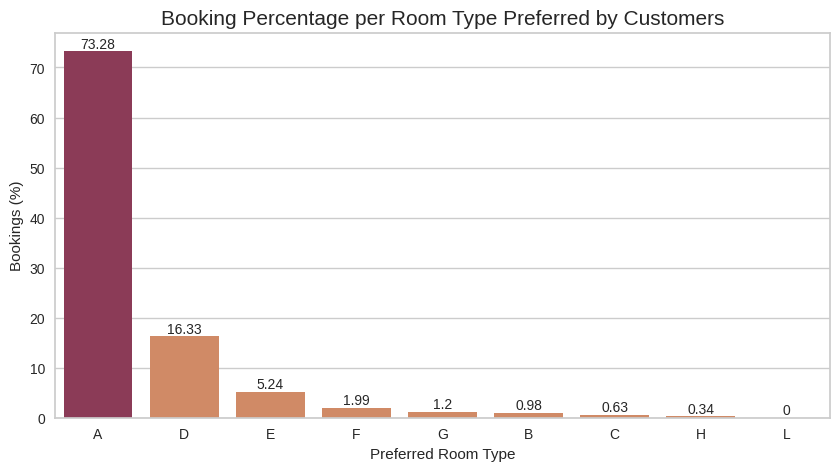

In [ ]:
fig, ax = plt.subplots(figsize=(10,5))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]

# Barchart for room preferred by customer
sns.barplot(x='index', y = 'reserved_room_type', data=preferred_room_bookings_percent, palette=colors)

ax.set_title("Booking Percentage per Room Type Preferred by Customers", fontsize=15)
ax.set_xlabel("Preferred Room Type")
ax.set_ylabel("Bookings (%)")
ax.bar_label(ax.containers[0], fontsize=10)

plt.show()

Observation:
* Most of customer preferred to reserved room type A (73.28%), followed by room type D (16.33%).
* The least preferred room type is room L

### Which meal type is most preferred by customers? (Meal Type)

In [ ]:
#'meal_booking' represent number of bookings by meal type
meal_booking = hotel['meal'].value_counts().reset_index(name='num_of_bookings')
meal_booking

,index,num_of_bookings
0,BB,61027
1,HB,8758
2,SC,8118
3,FB,474


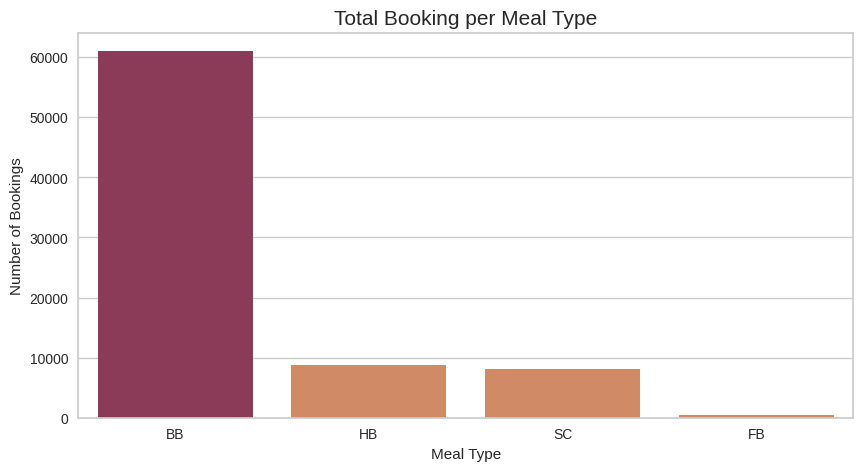

In [ ]:
fig, ax = plt.subplots(figsize=(10,5))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455","#E18455"]

# Barchart for meal type
sns.barplot(x='index', y = 'num_of_bookings', data=meal_booking, palette=colors)

ax.set_title("Total Booking per Meal Type", fontsize=15)
ax.set_xlabel("Meal Type")
ax.set_ylabel("Number of Bookings")
# ax.bar_label(ax.containers[0], fontsize=10)

plt.show()

Observation:
* Most of customers prefer to book a room with breakfast(BB / Bed and Breakfast).
* Very few customers book a room with FB (Full Board) meal type.

### Which market segment are most likely to booked hotel? (Market Segment)

In [ ]:
#'market_segment_booking' represent number of bookings by market segment
market_segment_booking = hotel['market_segment'].value_counts().reset_index(name='num_of_bookings')
market_segment_booking

,index,num_of_bookings
0,Online TA,37505
1,Offline TA/TO,16128
2,Groups,12296
3,Direct,8086
4,Corporate,3689
5,Complementary,513
6,Aviation,160


Text(0, 0.5, 'Number of Bookings')

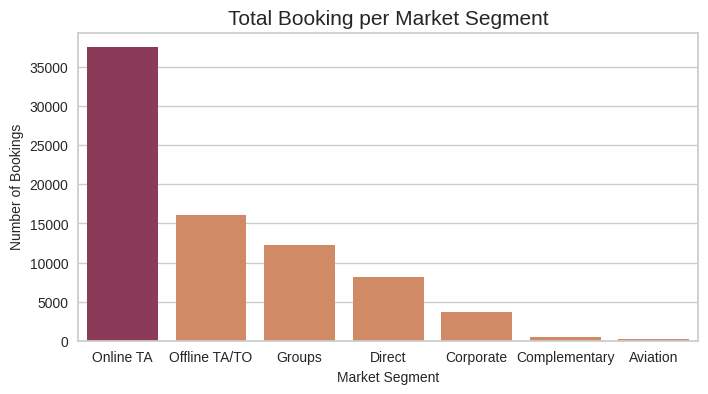

In [ ]:
# Set plot size
fig, ax = plt.subplots(figsize=(8, 4))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]

# Draw bar chart market segment
sns.barplot(x='index', y = 'num_of_bookings', data=market_segment_booking, palette=colors)

# Set title and label for bar chart
ax.set_title('Total Booking per Market Segment', fontsize = 15)
ax.set_xlabel('Market Segment', fontsize=10)
ax.set_ylabel('Number of Bookings', fontsize=10)
# ax.bar_label(ax.containers[0], fontsize = 10)

Observation:
* Most of booking reservations are made through online platform.

### Which distribution channel are most likely used to book the hotel? (Distribution Channel)

In [ ]:
#'channel_booking' represent number of bookings by distribution_channel
channel_booking = hotel['distribution_channel'].value_counts().reset_index(name='num_of_bookings')
channel_booking

,index,num_of_bookings
0,TA/TO,64251
1,Direct,9436
2,Corporate,4557
3,GDS,133


Text(0, 0.5, 'Number of Bookings')

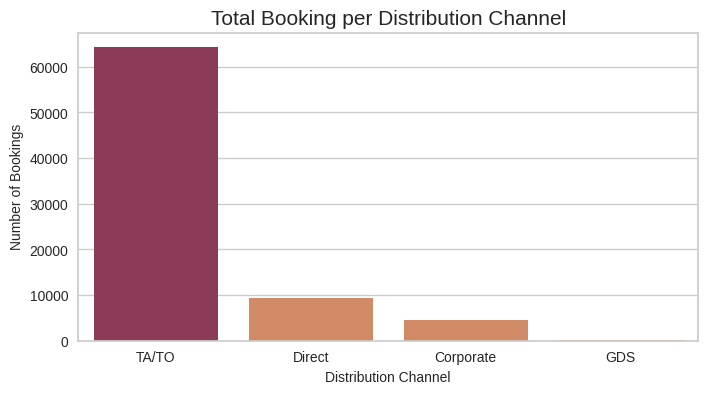

In [ ]:
# Set plot size
fig, ax = plt.subplots(figsize=(8, 4))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455"]

# Draw bar chart market segment
sns.barplot(x='index', y = 'num_of_bookings', data=channel_booking, palette=colors)

# Set title and label for bar chart
ax.set_title('Total Booking per Distribution Channel', fontsize = 15)
ax.set_xlabel('Distribution Channel', fontsize=10)
ax.set_ylabel('Number of Bookings', fontsize=10)
# ax.bar_label(ax.containers[0], fontsize = 10)

Observation:
* Most of booking reservations are made through travel agency or tour operators (TA/TO)

### Which type of hotel guest that booked reservation the most? (Guest Type)

In [ ]:
# 'percentage_booking_guest' represent proportion of number of booking by guest type
percentage_booking_guest = hotel['guest_type'].value_counts(normalize=True).mul(100).round(2)
percentage_booking_guest

couple    69.07
single    19.99
group     10.94
Name: guest_type, dtype: float64

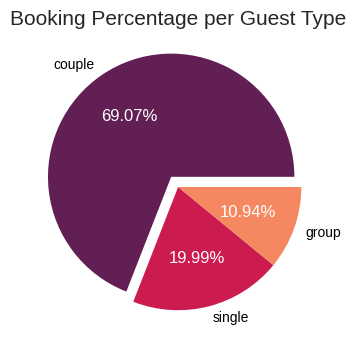

In [ ]:
# Set plot size
fig, ax = plt.subplots(figsize=(8, 4))

# Set explode
explode = [0.1, 0,0]

# Set label
label = ['couple','single','group']

# Draw pie chart for cancellation status
wedges, texts, autotexts = ax.pie(percentage_booking_guest, labels=label, colors=sns.color_palette('rocket',3),
          explode=explode, autopct='%.2f%%', textprops={'color':'white'})

# Set cancellation status label color from white to black
for text in texts:
  text.set_color('black')

# Set title for pie chart
ax.set_title('Booking Percentage per Guest Type', fontsize = 15)

plt.show()

Observation:
* Most of reservations are made for couples. 20% of reservations are made for single guest and the rest is for groups or families.

### Which customer type that booked reservation the most? (Customer Type)

In [ ]:
#'customer_type_booking' represent number of bookings by customer type
customer_type_booking = hotel['customer_type'].value_counts().reset_index(name='num_of_bookings')
customer_type_booking

,index,num_of_bookings
0,Transient,58771
1,Transient-Party,16502
2,Contract,2719
3,Group,385


Text(0, 0.5, 'Number of Bookings')

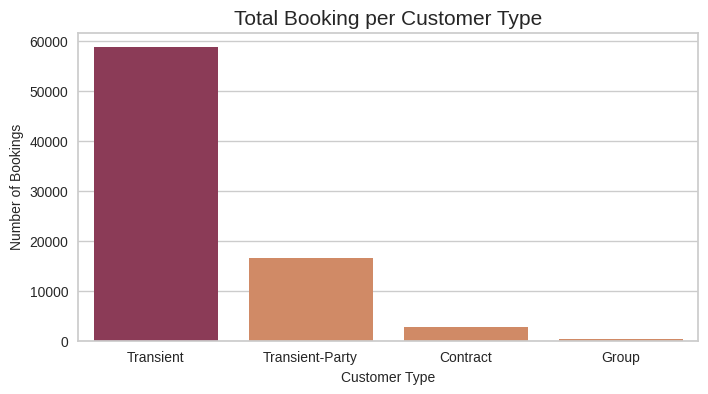

In [ ]:
# Set plot size
fig, ax = plt.subplots(figsize=(8, 4))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455"]

# Draw bar chart market segment
sns.barplot(x='index', y = 'num_of_bookings', data=customer_type_booking, palette=colors)

# Set title and label for bar chart
ax.set_title('Total Booking per Customer Type', fontsize = 15)
ax.set_xlabel('Customer Type', fontsize=10)
ax.set_ylabel('Number of Bookings', fontsize=10)
# ax.bar_label(ax.containers[0], fontsize = 10)

Observation:
* Most of booking reservation are booked for transient customer type

### Which deposit type is preferred by customers? (deposit type)

In [ ]:
# 'percentage_booking_deposit' represent proportion of number of booking by deposit type
percentage_booking_deposit = hotel['deposit_type'].value_counts(normalize=True).mul(100).round(2)
percentage_booking_deposit = percentage_booking_deposit.reset_index(name='proportions')
percentage_booking_deposit

,index,proportions
0,No Deposit,88.45
1,Non Refund,11.42
2,Refundable,0.14


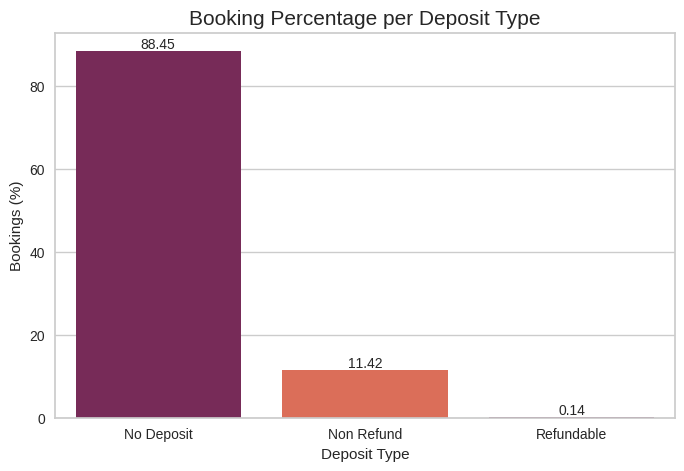

In [ ]:
# Set plot size
plt.figure(figsize=(8, 5))

# Draw bar chart for deposit type
ax = sns.barplot(x = 'index', y = 'proportions', data=percentage_booking_deposit,
                 palette = sns.color_palette('rocket',2))

# Set title and label
ax.set_title('Booking Percentage per Deposit Type', fontsize = 15)
ax.set_xlabel('Deposit Type')
ax.set_ylabel('Bookings (%)')
ax.bar_label(ax.containers[0], fontsize = 10)

plt.show()

Observation:
* More than 80% of customers don't want to pay pre-deposit for a reservation.
* Very few customers opt for a refundable deposit type, indicating that the customers perceive the deposit refund process is too tedious.

### Average of Duration Stay

In [ ]:
avg_duration_stay = hotel['total_stay_nights'].mean()
print('Average of Duration Stay (Nights):', avg_duration_stay.round().astype(int))

Average of Duration Stay (Nights): 3


### How long do the guests stay at the hotels? (Duration Stay)

In [ ]:
byduration = hotel['total_stay_nights'][hotel['is_canceled']==0].value_counts().reset_index()
byduration.columns = ['duration_stay', 'num_of_bookings']
byduration = byduration.sort_values('duration_stay')
byduration


,duration_stay,num_of_bookings
10,0,429
0,1,10733
2,2,10197
1,3,10413
3,4,7409
5,5,3450
6,6,1481
4,7,3724
8,8,475
11,9,343


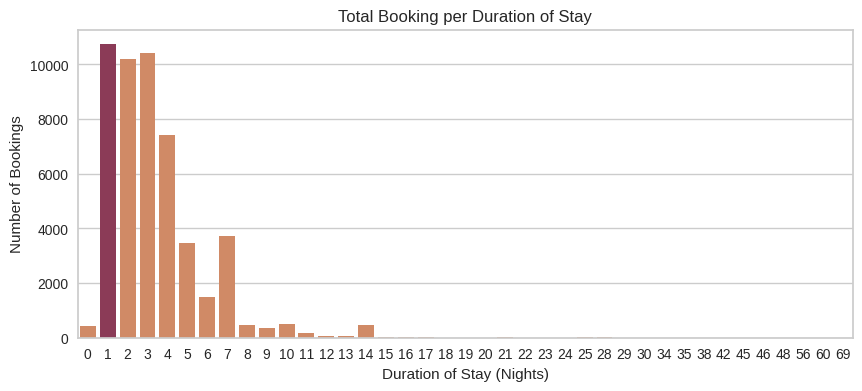

In [ ]:
plt.figure(figsize=(10, 4))

colors = ["#E18455","#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455",
          "#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455",
          "#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455",
          "#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]

sns.barplot(x='duration_stay', y='num_of_bookings', data=byduration, palette=colors)

plt.title('Total Booking per Duration of Stay')
plt.xlabel('Duration of Stay (Nights)')
plt.ylabel('Number of Bookings')

plt.show()


Observation:
* Most customers preferred to book a hotel for a short stay (less than 5 nights).
* The highest number of customers booked hotel with duration of stay for 1 night.

### When is the busiest year and month? (Arrival date by Year and Month)

In [ ]:
# Create dataframe of total guests per year
byarrival_year = hotel[hotel['is_canceled']==0].groupby('arrival_date_year').total_guests.sum().reset_index()

# Sort 'byarrival_year' by year
byarrival_year = byarrival_year.sort_values('arrival_date_year')

byarrival_year

,arrival_date_year,total_guests
0,2017,17828
1,2018,47206
2,2019,30688


Text(0, 0.5, 'Total guests')

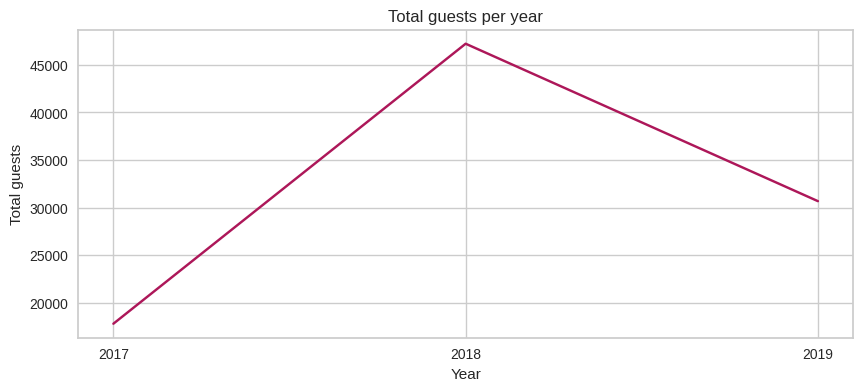

In [ ]:
# Set figure size
plt.figure(figsize=(10, 4))

# Draw line plot for total bookings per arrival year
sns.lineplot(x=['2017','2018','2019'], y='total_guests', data = byarrival_year, color = '#ad1759')

plt.title("Total guests per year")
plt.xlabel("Year")
plt.ylabel("Total guests")

Observation:
* The most busiest year is in 2018.

In [ ]:
# Create dataframe of total guests per month
byarrival_month = hotel[hotel['is_canceled']==0].groupby('arrival_date_month').total_guests.sum().reset_index()

# Create array of sorted month
sort_month = ['January','February','March','April','May','June','July','August','September','October','November','December']

# Set sort month
byarrival_month['arrival_date_month'] = pd.Categorical(
    byarrival_month['arrival_date_month'],
    sort_month,
    ordered=True
)

# Sort 'byarrival_month' by month
byarrival_month = byarrival_month.sort_values('arrival_date_month')

byarrival_month

,arrival_date_month,total_guests
4,January,5084
3,February,6734
7,March,8444
0,April,8748
8,May,8993
6,June,8354
5,July,10481
1,August,10783
11,September,8259
10,October,8440


Text(0, 0.5, 'Total guests')

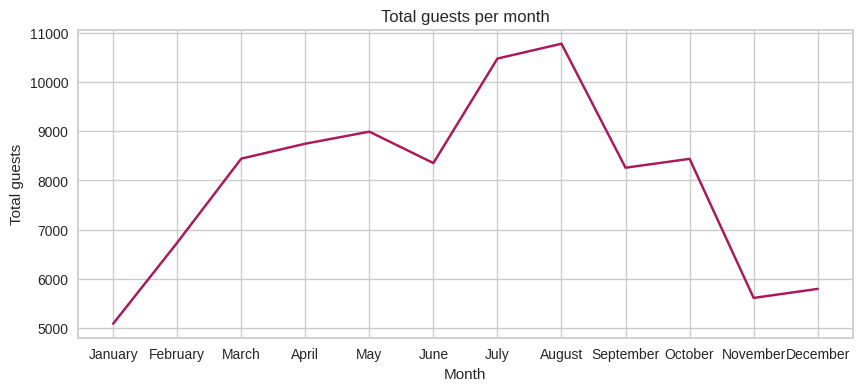

In [ ]:
# Set figure size
plt.figure(figsize=(10, 4))

# Draw line plot for total bookings per arrival month
sns.lineplot(x='arrival_date_month', y='total_guests', data = byarrival_month, color = '#ad1759')

plt.title("Total guests per month")
plt.xlabel("Month")
plt.ylabel("Total guests")

Observation:
* Most guests comes in August, followed by July. This is due to the fact that July to August is the summer holiday season.
* However, in January, November, and December, the number of guests is very low. This is possible because people are most likely spend winter at their own house or visit their family at their hometown.

### Which country makes the most reservation? (Country)

In [ ]:
# Group by Country
bycountry_df = hotel.groupby(by='country').bookingID.nunique().sort_values(ascending=False)
bycountry_df = bycountry_df.reset_index()

# Rename bookingID to count
bycountry_df.rename(columns={
    "bookingID" : "num_of_bookings"
}, inplace=True)

bycountry_df

,country,num_of_bookings
0,PRT,31474
1,GBR,7953
2,FRA,7016
3,ESP,5432
4,DEU,4731
...,...,...
158,KNA,1
159,STP,1
160,SDN,1
161,SMR,1


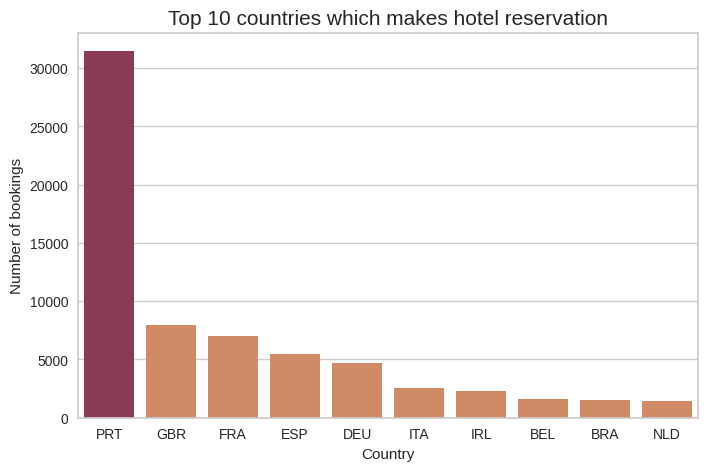

In [ ]:
# Set plot size
plt.figure(figsize=(8, 5))

colors = ["#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]
sns.barplot(y='num_of_bookings', x = 'country', data = bycountry_df.head(10), palette=colors)

plt.title("Top 10 countries which makes hotel reservation", fontsize=15)
plt.xlabel("Country")
plt.ylabel("Number of bookings")

plt.show()

### How many guest booked reservation repeatedly?

In [ ]:
# 'total_repeat' represent number of bookings by repeated status
total_repeat = hotel['is_repeated_guest'][hotel['is_canceled']==0].value_counts()
total_repeat

0    47871
1     2183
Name: is_repeated_guest, dtype: int64

In [ ]:
# 'percentage_repeat' represent proportion of number of booking by repeated status
percentage_repeat = hotel['is_repeated_guest'][hotel['is_canceled']==0].value_counts(normalize=True).mul(100).round(2)
percentage_repeat

0    95.64
1     4.36
Name: is_repeated_guest, dtype: float64

Text(0.5, 1.0, 'Percentage of Hotel Guests which Booked Hotel Repeatedly')

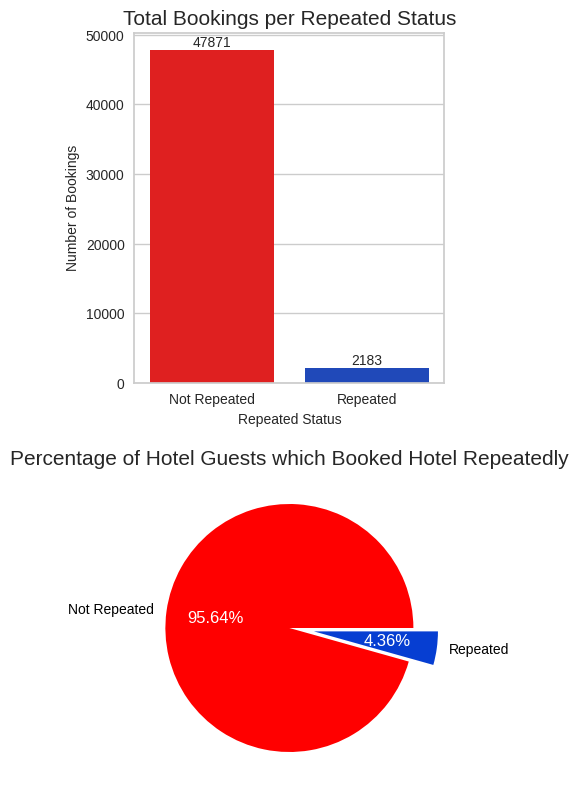

In [ ]:
# Label for bar chart
label = ['Not Repeated', 'Repeated']

# Set plot size
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(4, 10))

# Draw bar chart for cancellation status
sns.barplot(x=label, y=total_repeat,
            palette = {'Not Repeated':'red','Repeated': '#063ed2'},
            ax=ax[0])

# Set title and label for bar chart
ax[0].set_title('Total Bookings per Repeated Status', fontsize = 15)
ax[0].set_xlabel('Repeated Status', fontsize=10)
ax[0].set_ylabel('Number of Bookings', fontsize=10)
ax[0].bar_label(ax[0].containers[0], fontsize = 10)

# Set explode
explode = [0, 0.2]

# Draw pie chart for cancellation status
wedges, texts, autotexts = ax[1].pie(percentage_repeat, labels=label, colors=['red','#063ed2'],
          explode=explode, autopct='%.2f%%', textprops={'color':'white'})

# Set cancellation status label color from white to black
for text in texts:
  text.set_color('black')

# Set title for pie chart
ax[1].set_title('Percentage of Hotel Guests which Booked Hotel Repeatedly', fontsize = 15)

Observation:
* Less than 5% of all guests return to visit hotel again which is very low.
* It is recommended for hotel companies to increase repeat bookings by understanding the motivations behind repeat booking and offering the right incentives.

### How many parking spaces are required by hotel guests?

In [ ]:
#'parking_request' represent proportions of number of bookings per parking space
parking_request = hotel['required_car_parking_spaces'][hotel['is_canceled']==0].value_counts(normalize=True).mul(100).round(2).reset_index()
parking_request.columns = ['total_parking_space', '%_guests']
parking_request

,total_parking_space,%_guests
0,0,90.61
1,1,9.35
2,2,0.03
3,3,0.01
4,8,0.00


[Text(0, 0, '90.61'),
 Text(0, 0, '9.35'),
 Text(0, 0, '0.03'),
 Text(0, 0, '0.01'),
 Text(0, 0, '0')]

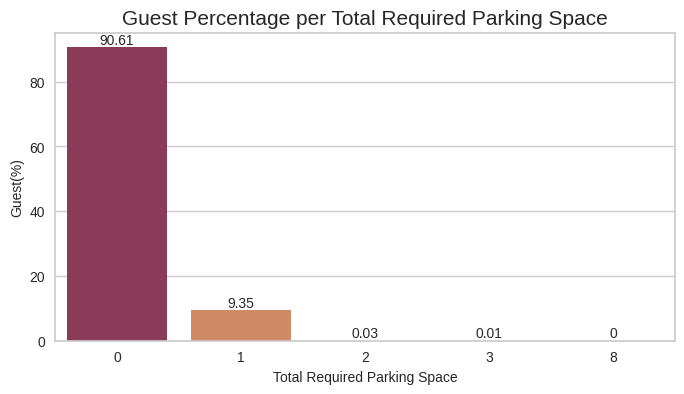

In [ ]:
# Set plot size
fig, ax = plt.subplots(figsize=(8, 4))

# Set colors for bar
colors = ["#982E53","#E18455","#E18455","#E18455","#E18455"]

# Draw bar chart market segment
sns.barplot(x='total_parking_space', y = '%_guests', data=parking_request, palette=colors)

# Set title and label for bar chart
ax.set_title('Guest Percentage per Total Required Parking Space', fontsize = 15)
ax.set_xlabel('Total Required Parking Space', fontsize=10)
ax.set_ylabel('Guest(%)', fontsize=10)
ax.bar_label(ax.containers[0], fontsize = 10)

Observation:
* More than 90% of guests do not require parking space for their car.

## Bivariate or Multivariate Analysis

### Which country that canceled reservation the most?

In [ ]:
top10_country = bycountry_df.loc[:9, 'country'].tolist()

# Stacked barchart
bycountry_bycancel_df = hotel.groupby(by=['country','is_canceled']).bookingID.nunique()
bycountry_bycancel_df = bycountry_bycancel_df.sort_values(ascending=False).reset_index()
bycountry_bycancel_df = bycountry_bycancel_df[bycountry_bycancel_df['country'].isin(top10_country)]

# Rename bookingID to count
bycountry_bycancel_df.rename(columns={
    "bookingID" : "num_of_bookings"
}, inplace=True)

# # Add column 'total_by_country' representing the total number of bookings grouped by 'country'
# bycountry_bycancel_df['total_by_country'] = bycountry_bycancel_df.groupby('country')['num_of_bookings'].transform('sum')

# # Add column `booking_proportion` representing proportion of cancelation rate grouped by 'country'
# bycountry_bycancel_df['booking_proportion'] = ((bycountry_bycancel_df['num_of_bookings'] / bycountry_bycancel_df['total_by_country']) * 100).round(2)
bycountry_bycancel_df

,country,is_canceled,num_of_bookings
0,PRT,1,17368
1,PRT,0,14106
2,GBR,0,6344
3,FRA,0,5749
4,ESP,0,4085
5,DEU,0,3909
6,IRL,0,1709
7,ITA,0,1636
8,GBR,1,1609
9,ESP,1,1347


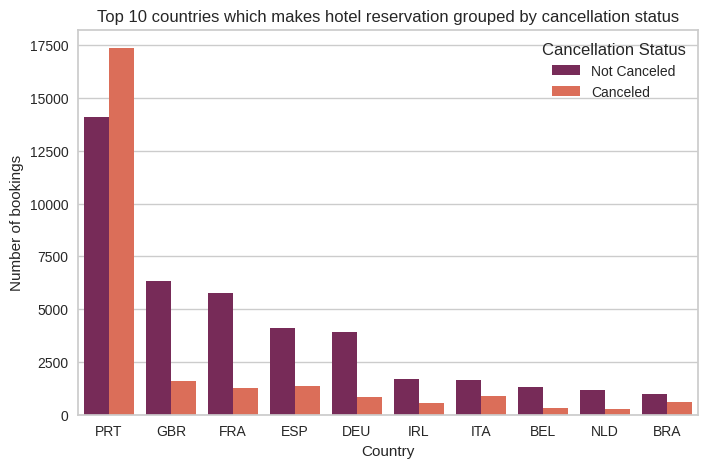

In [ ]:
# Set plot size
plt.figure(figsize=(8, 5))

ax = sns.barplot(y='num_of_bookings', x = 'country', hue='is_canceled', data = bycountry_bycancel_df, palette = sns.color_palette("rocket", 2))

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

# Set title and label
plt.title("Top 10 countries which makes hotel reservation grouped by cancellation status")
plt.ylabel("Number of bookings")
plt.xlabel("Country")


plt.show()



Observation:
* Although most of the customers who reserved hotel are from Portugal (PRT), it is also the country that is more likely to cancel their reservation.

In [ ]:
# # Group by Country and Canceled
# bycountry_canceled_df = hotel[hotel['is_canceled']==1].groupby(by='country').bookingID.nunique().sort_values(ascending=False)
# bycountry_canceled_df = bycountry_canceled_df.reset_index()

# # Rename bookingID to count
# bycountry_canceled_df.rename(columns={
#     "bookingID" : "num_of_bookings"
# }, inplace=True)

# # Add booking percentage to `booking_percentage`
# total_bookings = bycountry_canceled_df['num_of_bookings'].sum()
# bycountry_canceled_df['booking_percentage'] = ((bycountry_canceled_df['num_of_bookings'] / total_bookings) * 100).round(2)
# bycountry_canceled_df

In [ ]:
# # Group by Country and Not Canceled
# bycountry_not_canceled_df = hotel[hotel['is_canceled']==0].groupby(by='country').bookingID.nunique().sort_values(ascending=False)
# bycountry_not_canceled_df = bycountry_not_canceled_df.reset_index()

# # Rename bookingID to count
# bycountry_not_canceled_df.rename(columns={
#     "bookingID" : "num_of_bookings"
# }, inplace=True)

# # Add booking percentage to `booking_percentage`
# total_bookings = bycountry_not_canceled_df['num_of_bookings'].sum()
# bycountry_not_canceled_df['booking_percentage'] = ((bycountry_canceled_df['num_of_bookings'] / total_bookings) * 100).round(2)
# bycountry_not_canceled_df

In [ ]:
# fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(24,6))

# # Set colors for bar
# colors = ["#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]

# # Barchart for country that cancel reservation the most
# sns.barplot(x='num_of_bookings', y = 'country', data = bycountry_canceled_df.head(10), palette=colors, ax=ax[0])

# ax[0].set_title("Top 10 countries that cancel reservation the most ")
# ax[0].set_xlabel("Number of bookings")
# ax[0].set_ylabel("Country")


# # Bar Chart for country that checked-in the most
# sns.barplot(x='num_of_bookings', y = 'country', data = bycountry_not_canceled_df.head(10), palette=colors, ax=ax[1])

# ax[1].set_title("Top 10 countries that checked-in the most")
# ax[1].set_xlabel("Number of bookings")
# ax[1].set_ylabel("Country")

# plt.show()

###  Which market segment has the highest cancellation rate?

In [ ]:
bycancel_market = hotel[['is_canceled','market_segment']]

# Find total bookings group per cancellation status and market segment
total_bookings_cancel_market = bycancel_market.groupby(['is_canceled','market_segment']).size()

# Find total bookings per market segment
total_bookings_market = bycancel_market.groupby('market_segment').size()

# 'percentage_cancel_market' represent cancellation rate per market segment
percentage_cancel_market = total_bookings_cancel_market / total_bookings_market * 100
percentage_cancel_market = percentage_cancel_market.reset_index(name='cancellation_rate')
percentage_cancel_market

,is_canceled,market_segment,cancellation_rate
0,0,Aviation,75.000000
1,0,Complementary,88.693957
2,0,Corporate,80.970453
3,0,Direct,85.035864
4,0,Groups,41.314249
5,0,Offline TA/TO,65.854415
6,0,Online TA,63.764831
7,1,Aviation,25.000000
8,1,Complementary,11.306043
9,1,Corporate,19.029547


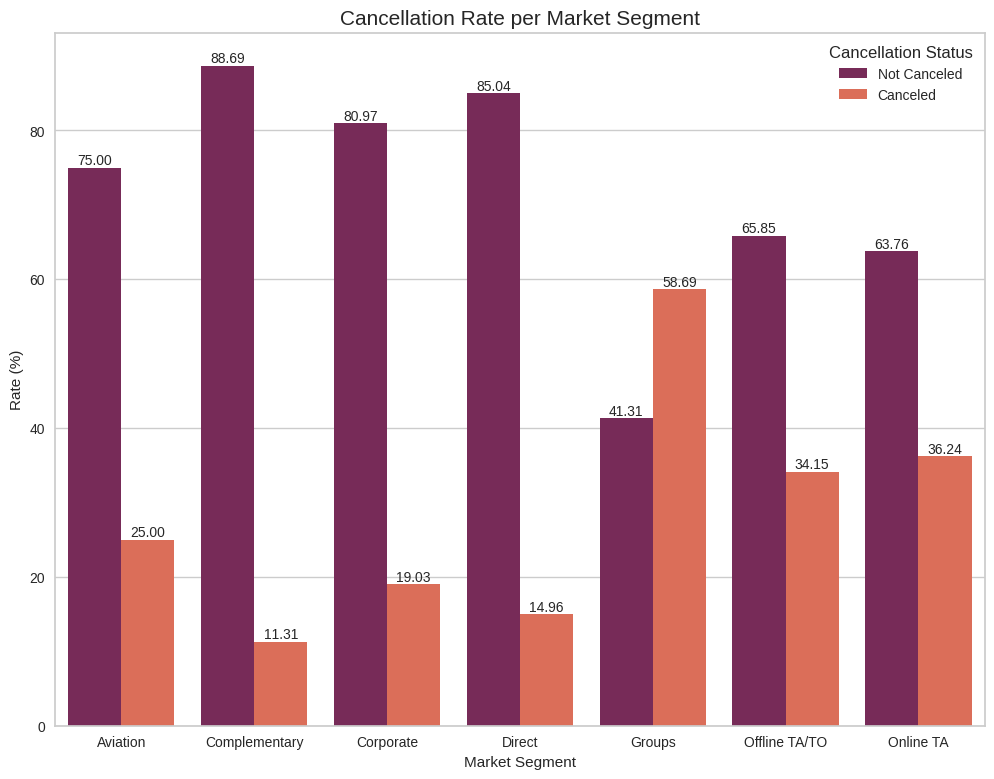

In [ ]:
fig, ax = plt.subplots(figsize=(12,9))

sns.barplot(y='cancellation_rate', x = 'market_segment', hue = 'is_canceled', data=percentage_cancel_market, palette=sns.color_palette("rocket", 2))

# Set label and title
ax.set_title("Cancellation Rate per Market Segment", fontsize=15)
ax.set_xlabel("Market Segment")
ax.set_ylabel("Rate (%)")

for container in ax.containers:
  ax.bar_label(container, fmt = '%.2f', fontsize = 10)

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

Observation:
* Bookings that made for groups have the highest chance to be cancelled. This may happen due to the fact that groups are more suspectible to changes in plan. For example, there are urgent matters may occur that cause the group had to change their plan and cancel their reservation.

### Which distribution channel has the highest cancellation rate?

In [ ]:
bycancel_channel = hotel[['is_canceled', 'distribution_channel']]

# Find total bookings group by cancellation status and distribution channel
total_bookings_cancel_channel = bycancel_channel.groupby(['is_canceled', 'distribution_channel']).size()

# Find total bookings
total_bookings_channel = bycancel_channel.groupby('distribution_channel').size()
# total_bookings_channel = bycancel_channel['distribution_channel'].value_counts().sum()

# 'percentage_cancel_channel' represent cancellation rate per distribution channel
percentage_cancel_channel = total_bookings_cancel_channel / total_bookings_channel * 100
percentage_cancel_channel = percentage_cancel_channel.reset_index(name='cancellation_rate')

percentage_cancel_channel

,is_canceled,distribution_channel,cancellation_rate
0,0,Corporate,77.660742
1,0,Direct,82.704536
2,0,GDS,80.451128
3,0,TA/TO,60.083112
4,1,Corporate,22.339258
5,1,Direct,17.295464
6,1,GDS,19.548872
7,1,TA/TO,39.916888


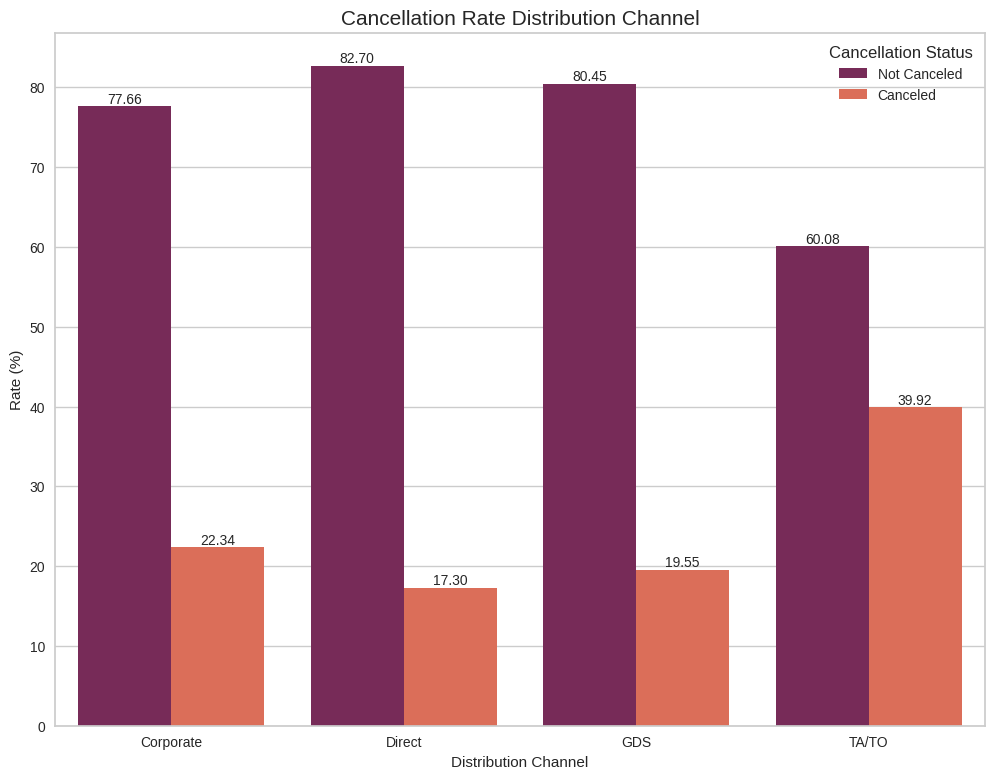

In [ ]:
fig, ax = plt.subplots(figsize=(12,9))

sns.barplot(y='cancellation_rate', x = 'distribution_channel', hue = 'is_canceled', data=percentage_cancel_channel, palette=sns.color_palette("rocket", 2))

# Set label and title
ax.set_title("Cancellation Rate Distribution Channel", fontsize=15)
ax.set_xlabel("Distribution Channel")
ax.set_ylabel("Rate (%)")

for container in ax.containers:
  ax.bar_label(container, fmt = '%.2f', fontsize = 10)

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

Observation:
* Bookings that made through distribution channel TA/TO have the highest chance to be cancelled.
* Bookings made from distribution channel corporate, direct, and GDS has lower chance to be cancelled.

### Cancellation Rate by Reserved Room Type

In [ ]:
bycancel_reservedroom = hotel[['is_canceled', 'reserved_room_type']]

# Find total bookings group by cancellation status and prefered room type
total_bookings_cancel_reserved = bycancel_reservedroom.groupby(['is_canceled', 'reserved_room_type']).size()

# Find total bookings group by prefered room type
total_bookings_reserved = bycancel_reservedroom.groupby('reserved_room_type').size()

# 'proportions_cancel_reserved' represent Cancellation Rate by Prefered Room Type (Group by Cancellation Status)
proportions_cancel_reserved = total_bookings_cancel_reserved / total_bookings_reserved * 100
proportions_cancel_reserved = proportions_cancel_reserved.reset_index(name='cancellation_rate')

proportions_cancel_reserved

,is_canceled,reserved_room_type,cancellation_rate
0,0,A,62.037327
1,0,B,67.624021
2,0,C,69.371197
3,0,D,68.106883
4,0,E,71.633796
5,0,F,71.300448
6,0,G,65.180467
7,0,H,64.552239
8,0,L,66.666667
9,1,A,37.962673


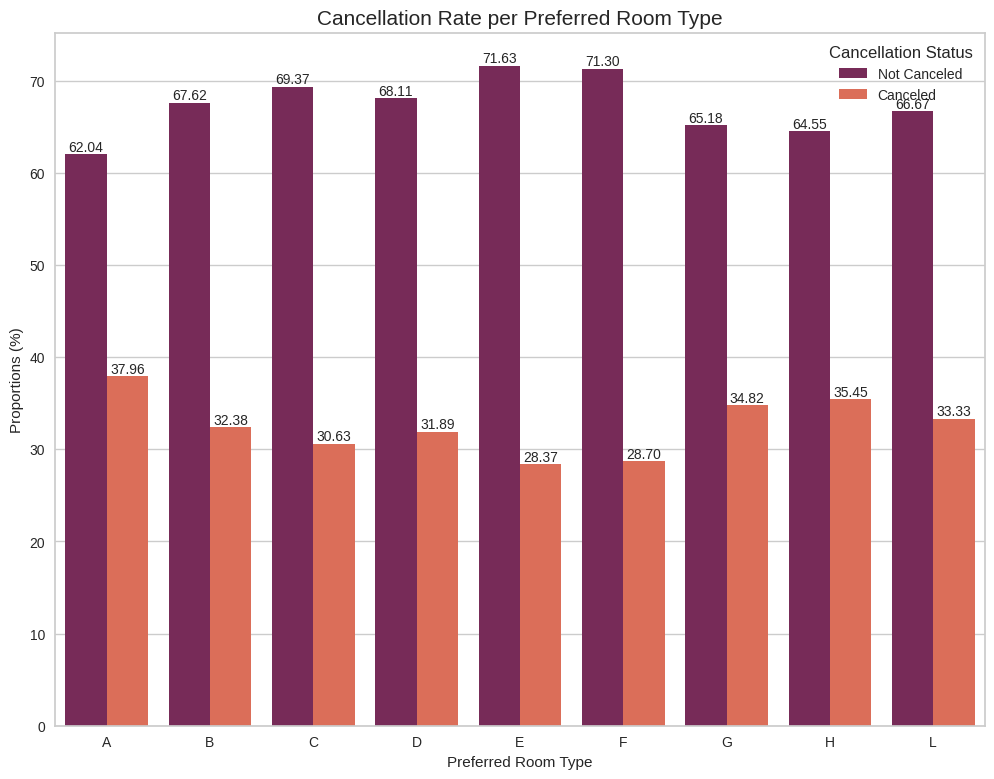

In [ ]:
fig, ax = plt.subplots(figsize=(12,9))

sns.barplot(y='cancellation_rate', x = 'reserved_room_type', hue = 'is_canceled', data=proportions_cancel_reserved, palette=sns.color_palette("rocket", 2))

# Set label and title
ax.set_title("Cancellation Rate per Preferred Room Type", fontsize=15)
ax.set_xlabel("Preferred Room Type")
ax.set_ylabel("Proportions (%)")

for container in ax.containers:
  ax.bar_label(container, fmt = '%.2f', fontsize = 10)

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

Observation:
* Although the most prefered room type by customer is room type A, but it is also has the highest chance that people will cancel their reservation with the chance of 37.96%.
* The lowest probability that people will cancel their reservation is people who reserved for room type E with the chance of 28.37%.

### Does assigned room change affect customer to cancel their reservation?

In [ ]:
bycancel_change = hotel[['is_canceled', 'is_assigned_change']]

# Find total bookings per assigned room changed group by cancellation status
total_bookings_cancel_change = bycancel_change.groupby(['is_canceled', 'is_assigned_change']).size()

# Find total bookings
total_bookings_change = bycancel_change['is_assigned_change'].value_counts().sum()


# 'percentage_cancel_change' represent Percentage of Bookings by Prefered Room Type (Group by Cancellation Status)
percentage_cancel_change = total_bookings_cancel_change / total_bookings_change * 100
percentage_cancel_change = percentage_cancel_change.reset_index(name='percentage')

# Mapping is_assigned_change where 0 : no, 1:yes
percentage_cancel_change['is_assigned_change'] = percentage_cancel_change['is_assigned_change'].map({0: 'No', 1: 'Yes'})
percentage_cancel_change

,is_canceled,is_assigned_change,percentage
0,0,No,51.666943
1,0,Yes,12.196180
2,1,No,35.441520
3,1,Yes,0.695357


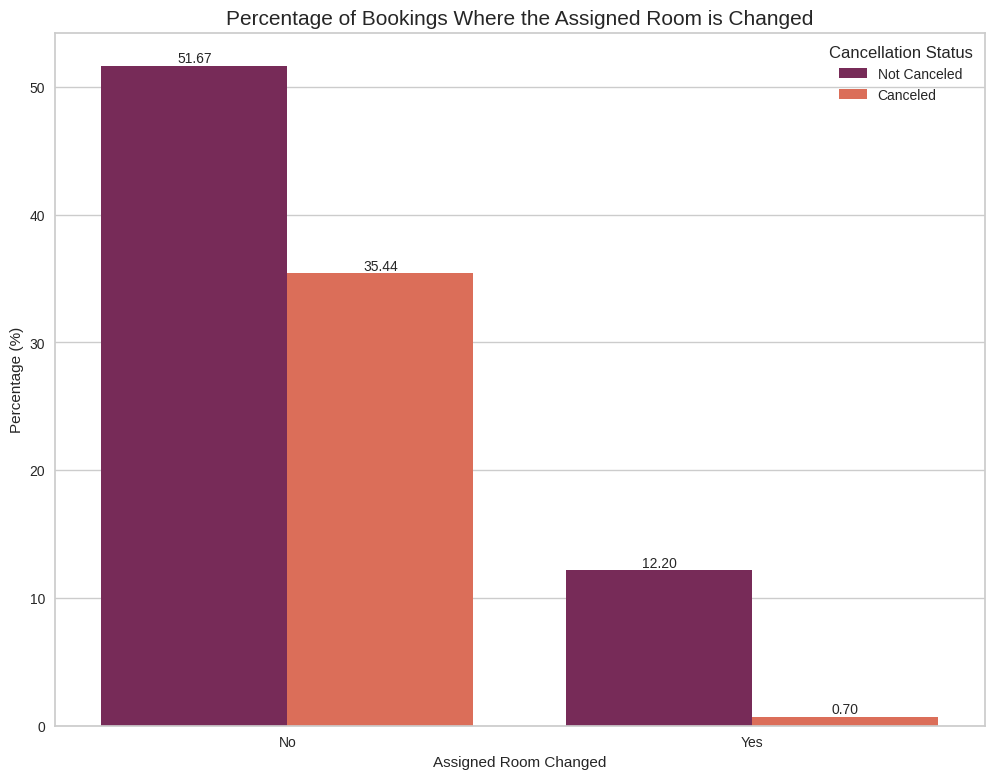

In [ ]:
fig, ax = plt.subplots(figsize=(12,9))

sns.barplot(y='percentage', x = 'is_assigned_change', hue = 'is_canceled', data=percentage_cancel_change, palette=sns.color_palette("rocket", 2))

# Set label and title
ax.set_title("Percentage of Bookings Where the Assigned Room is Changed", fontsize=15)
ax.set_xlabel("Assigned Room Changed")
ax.set_ylabel("Percentage (%)")

for container in ax.containers:
  ax.bar_label(container, fmt = '%.2f', fontsize = 10)

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

Observation:
* There are less than 1% customer who canceled reservation when their assigned room are different as they reserved. We can assumed that assigned room changes are not the main reason customers cancel their reservation.

### Which guest type has the highest cancellation rate?

In [ ]:
bycancel_guest = hotel[['is_canceled', 'guest_type']]

# Find total bookings group by cancellation status and guest type
total_bookings_cancel_guest = bycancel_guest.groupby(['is_canceled', 'guest_type']).size()

# Find total bookings group by guest type
total_bookings_guest = bycancel_guest.groupby('guest_type').size()

# 'proportions_cancel_guest' represent Cancellation Rate by Prefered Room Type (Group by Cancellation Status)
proportions_cancel_guest = total_bookings_cancel_guest / total_bookings_guest * 100
proportions_cancel_guest = proportions_cancel_guest.reset_index(name='cancellation_rate')

proportions_cancel_guest

,is_canceled,guest_type,cancellation_rate
0,0,couple,61.435301
1,0,group,65.729616
2,0,single,71.229817
3,1,couple,38.564699
4,1,group,34.270384
5,1,single,28.770183


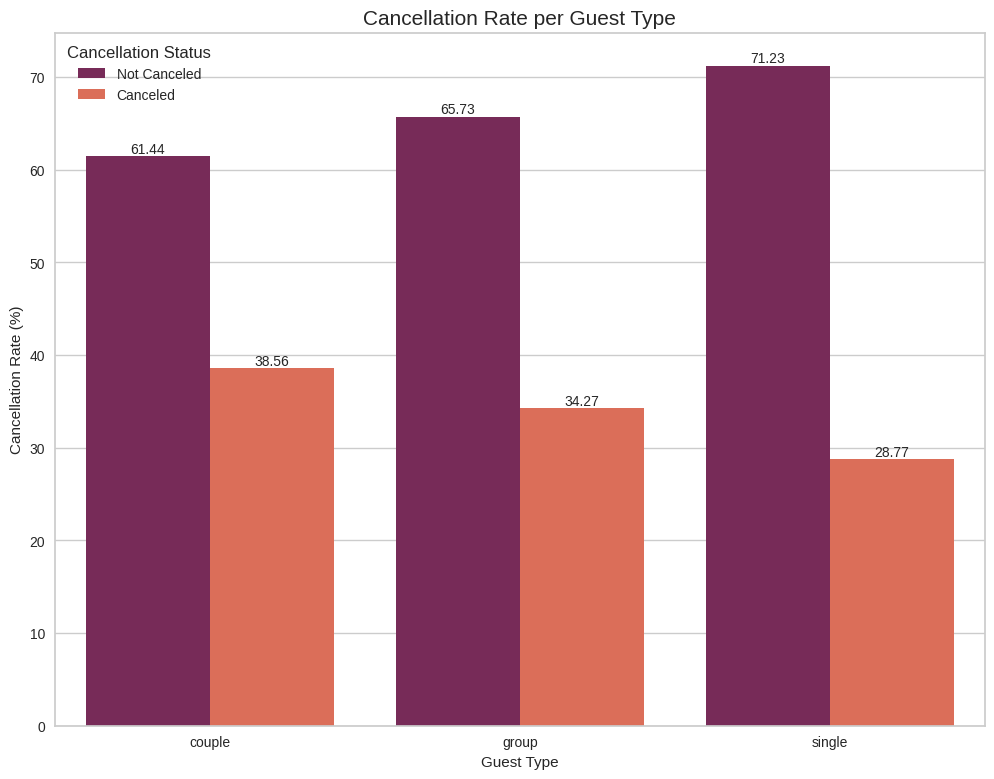

In [ ]:
fig, ax = plt.subplots(figsize=(12,9))

sns.barplot(y='cancellation_rate', x = 'guest_type', hue = 'is_canceled', data=proportions_cancel_guest, palette=sns.color_palette("rocket", 2))

# Set label and title
ax.set_title("Cancellation Rate per Guest Type", fontsize=15)
ax.set_xlabel("Guest Type")
ax.set_ylabel("Cancellation Rate (%)")

for container in ax.containers:
  ax.bar_label(container, fmt = '%.2f', fontsize = 10)

# Set legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Canceled', 'Canceled'],title='Cancellation Status')

### In terms of guest type, how many special request they requested?

In [ ]:
byguest_special = hotel[['guest_type','total_of_special_requests']]

# Find total guest type per special request
total_guest_special = byguest_special.groupby(['guest_type','total_of_special_requests']).size()
total_guest_special = total_guest_special.reset_index(name='count')
total_guest_special

,guest_type,total_of_special_requests,count
0,couple,0,30911
1,couple,1,16326
2,couple,2,5747
3,couple,3,1004
4,couple,4,128
5,couple,5,19
6,group,0,3523
7,group,1,2695
8,group,2,1845
9,group,3,445


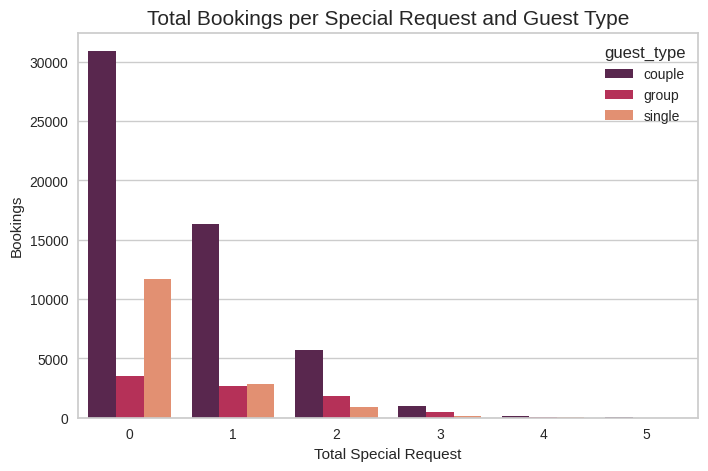

In [ ]:
fig, ax = plt.subplots(figsize=(8,5))

sns.barplot(y='count', x = 'total_of_special_requests', hue = 'guest_type', data=total_guest_special, palette=sns.color_palette("rocket", 3))

# Set label and title
ax.set_title("Total Bookings per Special Request and Guest Type", fontsize=15)
ax.set_xlabel("Total Special Request")
ax.set_ylabel("Bookings")

plt.show()

### Does changes in assigned room also affecting income?

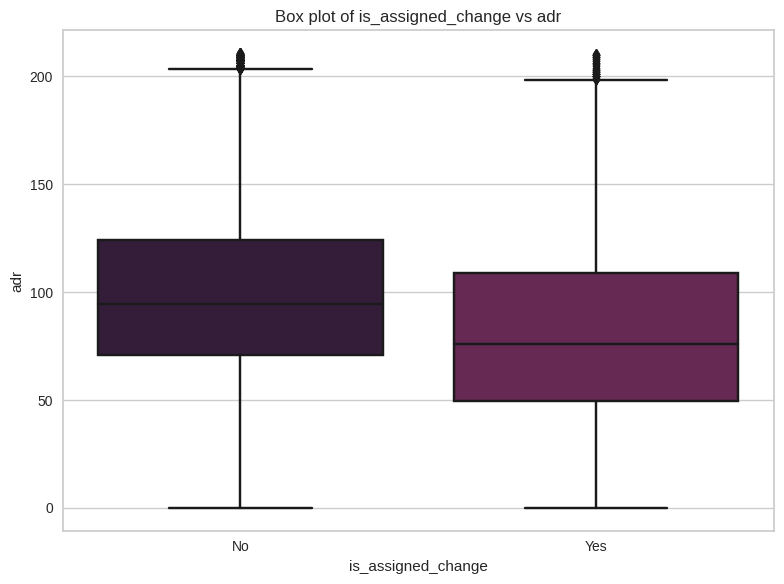

In [ ]:
byadr_isassigned = hotel[['is_assigned_change','adr']][hotel['is_canceled']==0]

# Map 'is_assigned_change' value where 0 : no, 1:yes
byadr_isassigned ['is_assigned_change'] = byadr_isassigned['is_assigned_change'].map({0: 'No', 1: 'Yes'})

plt.figure(figsize=(8,6))

# Box plot of assigned room type vs adr
ax=sns.boxplot(x='is_assigned_change', y='adr',data=byadr_isassigned, palette=sns.color_palette('rocket'))

# Set title
ax.set_title('Box plot of is_assigned_change vs adr')

plt.tight_layout()
plt.show()

### Which guest type generate most of the revenue?

Text(0.5, 0, 'Guest Type')

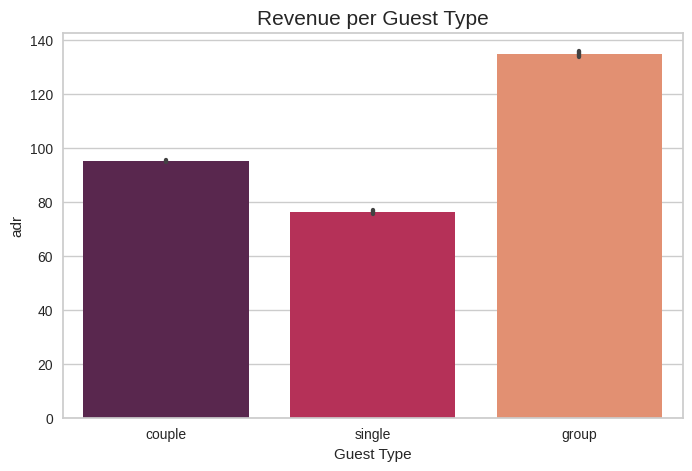

In [ ]:
plt.figure(figsize=(8,5))

sns.barplot(x='guest_type', y='adr', data=hotel[hotel['is_canceled'] == 0], palette=sns.color_palette('rocket',3))

plt.title('Revenue per Guest Type', fontsize=15)
plt.xlabel('Guest Type')

Observation:
* Guests who reserved room for groups(more than 2 people) gives the highest revenue.
* Guests who reserved room for single gives the lowest revenue.

### Which room generates most of the revenue?

In [ ]:
# byadr_roomtype = hotel[['assigned_room_type','adr']][hotel['is_canceled']==0]

# # Find adr per assigned room type
# adr_room = byadr_roomtype.groupby('assigned_room_type').adr.mean().reset_index()
# adr_room = adr_room.sort_values('adr',ascending=False)
# adr_room

In [ ]:
# plt.figure(figsize=(8,5))

# # Set colors for bar
# colors = ["#982E53","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455","#E18455"]

# sns.barplot(x = 'assigned_room_type', y='adr', data=adr_room, palette=colors)

# plt.title('Average Daily Rates per Room Type', fontsize=15)
# plt.xlabel('Room Type')

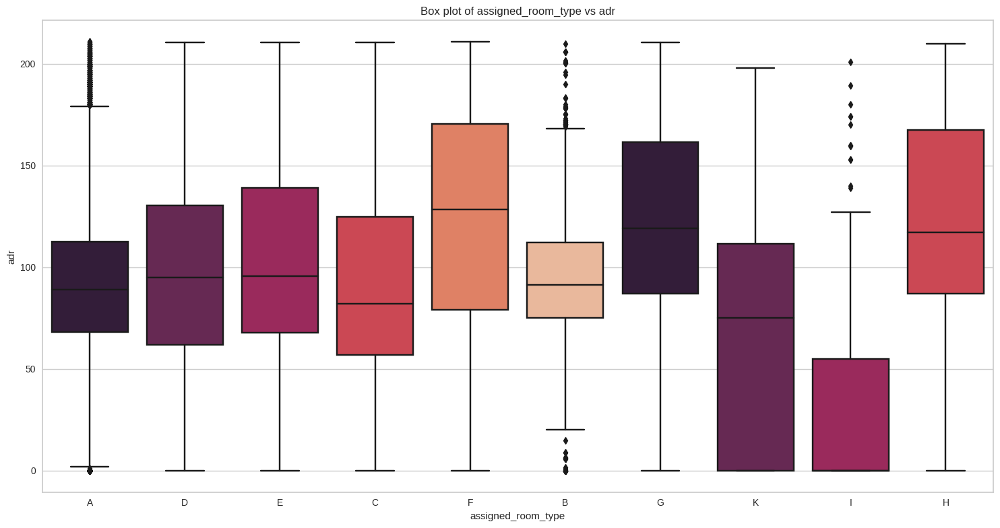

In [ ]:
byadr_roomtype = hotel[['assigned_room_type','adr']][hotel['is_canceled']==0]

plt.figure(figsize=(15,8))

# Box plot of assigned room type vs adr
ax=sns.boxplot(x='assigned_room_type', y='adr',data=byadr_roomtype, palette=sns.color_palette('rocket'))

# Set title
ax.set_title('Box plot of assigned_room_type vs adr')

plt.tight_layout()
plt.show()

Observation:
* Room type F gives the highest revenue, followed by room type H and G.
* Despite customers favorite room type is room A, but room A is one of the room type that gives low revenue.

### How many guest stay at hotel per month?

In [ ]:
# Create dataframe of total guests per month and guest type
byarrival_month_guest = hotel[hotel['is_canceled']==0].groupby(['arrival_date_month','guest_type']).size()
byarrival_month_guest = byarrival_month_guest.reset_index(name='total_guest')

# Get the unique values in the 'arrival_date_month' column
unique_months = byarrival_month_guest['arrival_date_month'].unique()

# Define the custom order for months
month_order = sorted(unique_months, key=lambda x: pd.to_datetime(x, format='%B'))

# Convert the 'arrival_date_month' column to a categorical type with the custom order
byarrival_month_guest['arrival_date_month'] = pd.Categorical(byarrival_month_guest['arrival_date_month'], categories=month_order, ordered=True)

# Sort the DataFrame by the custom-ordered 'arrival_date_month'
byarrival_month_guest = byarrival_month_guest.sort_values(by='arrival_date_month', key=lambda x: x.cat.codes)
byarrival_month_guest

,arrival_date_month,guest_type,total_guest
14,January,single,1042
13,January,group,242
12,January,couple,1626
11,February,single,1037
10,February,group,420
9,February,couple,2171
21,March,couple,2958
23,March,single,1212
22,March,group,411
0,April,couple,3112


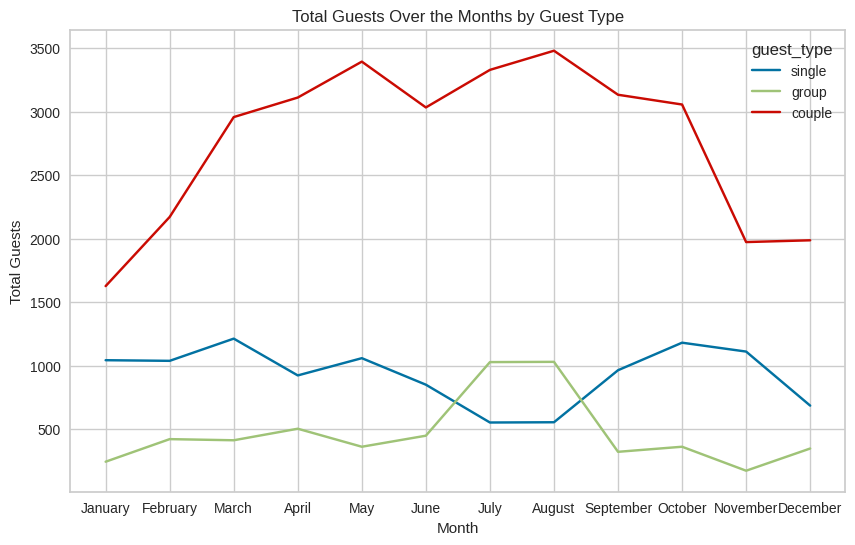

In [ ]:
plt.figure(figsize=(10, 6))

sns.lineplot(x='arrival_date_month', y='total_guest', hue='guest_type', data=byarrival_month_guest)

# Set labels and title
plt.xlabel('Month')
plt.ylabel('Total Guests')
plt.title('Total Guests Over the Months by Guest Type')

plt.show()

# Modeling

In [ ]:
# Define predictor variable
X = hotel.drop(['is_canceled'],axis=1)

# Define target variable
y = hotel['is_canceled']

print(X.columns)

Index(['hotel', 'lead_time', 'arrival_date_year', 'arrival_date_month',
       'arrival_date_week_number', 'arrival_date_day_of_month', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'bookingID',
       'total_guests', 'total_stay_nights', 'is_assigned_change',
       'guest_type'],
      dtype='object')


## Drop Irrelevant Column

In [ ]:
dropped_column = [
    # Time
    'arrival_date_year', 'arrival_date_month', 'arrival_date_week_number', 'arrival_date_day_of_month',
    'reservation_status_date',

    # Identity
    'bookingID','hotel','country','agent',

    # Already represented by 'is_assigned_change'
    'reserved_room_type','assigned_room_type',

    # Already represented by 'is_canceled'
    'reservation_status']

X = X.drop(dropped_column, axis=1)
print(X.columns)

Index(['lead_time', 'meal', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'total_guests', 'total_stay_nights', 'is_assigned_change',
       'guest_type'],
      dtype='object')


## Check for multicollinearity

In [ ]:
# Seperate category and numeric column
X_cat = X.select_dtypes(exclude=['number'])
X_num = X.select_dtypes(include=['number'])

print('Category:')
print(X_cat.columns)

print('Numeric:')
print(X_num.columns)

Category:
Index(['meal', 'market_segment', 'distribution_channel', 'deposit_type',
       'customer_type', 'guest_type'],
      dtype='object')
Numeric:
Index(['lead_time', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'booking_changes',
       'days_in_waiting_list', 'adr', 'required_car_parking_spaces',
       'total_of_special_requests', 'total_guests', 'total_stay_nights',
       'is_assigned_change'],
      dtype='object')


In [ ]:
# 'X_numeric_only' consist of data that only numerical (doesn't include labeled category)
drop_cat_num = ['is_repeated_guest', 'is_assigned_change']
X_numeric_only = X_num.drop(drop_cat_num, axis=1)
X_numeric_only

,lead_time,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,total_guests,total_stay_nights
0,8,0,0,0,0,38.40,0,0,2,4
1,175,0,0,0,0,110.00,0,0,2,3
2,0,0,0,0,0,45.00,0,0,1,1
3,33,0,0,0,0,57.92,0,1,2,5
4,205,0,0,0,0,150.75,0,2,2,4
...,...,...,...,...,...,...,...,...,...,...
78372,4,0,0,0,0,169.00,1,1,3,2
78373,30,0,0,0,0,94.50,0,2,2,4
78374,165,0,0,0,0,123.50,0,1,2,14
78375,180,0,0,0,0,122.25,0,1,3,6



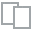
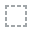
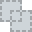
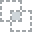
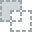
...
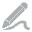
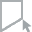
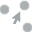
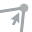
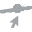

In [ ]:
plot_correlation(X_numeric_only)

## Label Encoder

In [ ]:
# Display 3 top rows for categorical data
X_cat.head(3)

,meal,market_segment,distribution_channel,deposit_type,customer_type,guest_type
0,BB,Online TA,TA/TO,No Deposit,Transient,couple
1,BB,Groups,TA/TO,Non Refund,Transient,couple
2,BB,Corporate,Corporate,No Deposit,Transient,single


In [ ]:
# Change categorical columns into numeric using Label Encoder
lb = LabelEncoder()

# Define all categorical column
X_cat_columns = X.select_dtypes(exclude=['number']).columns.tolist()

# Label encoding for all categorical column in X
for column in X_cat_columns:
    X[column] = lb.fit_transform(X[column])

# Show all categorical data that has been encoded
X[X_cat_columns].head(3)

,meal,market_segment,distribution_channel,deposit_type,customer_type,guest_type
0,0,6,3,0,2,0
1,0,4,3,1,2,0
2,0,2,0,0,2,2


## Train-Test Split Data

In [ ]:
# Split data into train and test set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.2, random_state = 123)

# Check X_train and X_test dimension
print("X_train dimension: ", X_train.shape)
print("X_test dimension: ", X_test.shape)

# check y_train and y_test dimension
print("y_train dimension: ", y_train.shape)
print("y_test dimension: ", y_test.shape)

X_train dimension:  (62701, 18)
X_test dimension:  (15676, 18)
y_train dimension:  (62701,)
y_test dimension:  (15676,)


## Find Best Model

In [ ]:
X_train['is_canceled'] = y_train
X_test['is_canceled'] = y_test
s = setup(X_train, test_data = X_test, target = 'is_canceled', session_id = 1)

,Description,Value
0,Session id,1
1,Target,is_canceled
2,Target type,Binary
3,Original data shape,"(78377, 19)"
4,Transformed data shape,"(78377, 19)"
5,Transformed train set shape,"(62701, 19)"
6,Transformed test set shape,"(15676, 19)"
7,Numeric features,18
8,Preprocess,True
9,Imputation type,simple


In [ ]:
# compare baseline models
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.8453,0.9104,0.7376,0.8170,0.7753,0.6578,0.6598,7.5050
et,Extra Trees Classifier,0.8387,0.9035,0.7338,0.8032,0.7669,0.6439,0.6455,7.2900
xgboost,Extreme Gradient Boosting,0.8380,0.9053,0.6829,0.8392,0.7530,0.6343,0.6418,0.8830
lightgbm,Light Gradient Boosting Machine,0.8341,0.9018,0.6590,0.8485,0.7418,0.6225,0.6333,1.9930
gbc,Gradient Boosting Classifier,0.8189,0.8835,0.6140,0.8428,0.7104,0.5833,0.5989,6.0320
ada,Ada Boost Classifier,0.8158,0.8712,0.6125,0.8342,0.7063,0.5767,0.5913,1.8320
dt,Decision Tree Classifier,0.8061,0.7940,0.7369,0.7298,0.7333,0.5810,0.5810,0.2980
lr,Logistic Regression,0.7988,0.8484,0.5459,0.8425,0.6624,0.5283,0.5536,7.0860
lda,Linear Discriminant Analysis,0.7739,0.8316,0.4299,0.8869,0.5790,0.4489,0.5039,0.3400
ridge,Ridge Classifier,0.7731,0.0000,0.4217,0.8962,0.5735,0.4450,0.5037,0.0960


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [ ]:
# check best model
best_model

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=1, verbose=0, warm_start=False)

# Evaluation Model

## Confusion Matrix

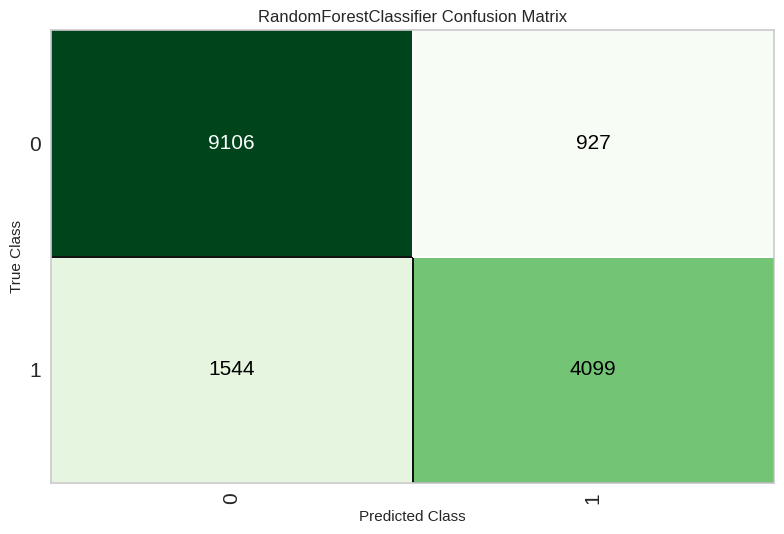

In [ ]:
# plot confusion matrix
plot_model(best_model, plot = 'confusion_matrix')

## AUC Curves

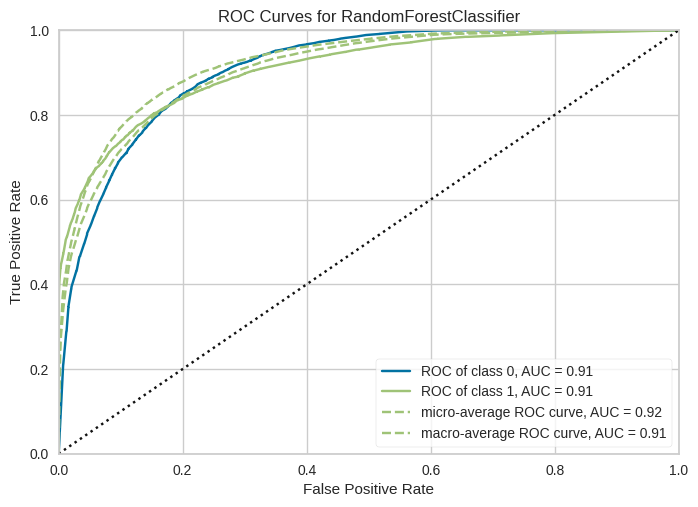

In [ ]:
# plot AUC
plot_model(best_model, plot = 'auc')

## Feature Importance

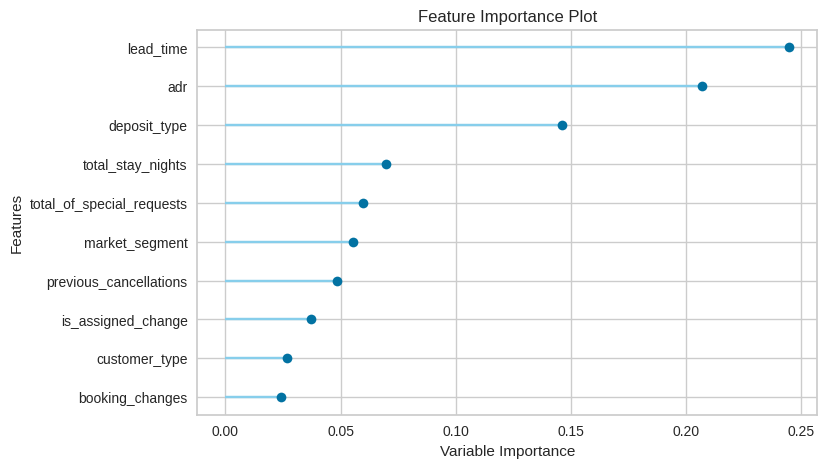

In [ ]:
# plot feature importance
plot_model(best_model, plot = 'feature')

## Prediction on test set

In [ ]:
# predict on test set
test_data_pred = predict_model(best_model)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.8424,0.9088,0.7264,0.8156,0.7684,0.6495,0.6520


In [ ]:
# show predictions df
test_data_pred.head()

,lead_time,meal,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,deposit_type,days_in_waiting_list,...,adr,required_car_parking_spaces,total_of_special_requests,total_guests,total_stay_nights,is_assigned_change,guest_type,is_canceled,prediction_label,prediction_score
49307,34,0,4,3,0,0,0,2,0,0,...,75.000000,0,0,1,1,0,2,0,0,1.00
11391,118,0,6,3,0,0,0,0,0,0,...,97.199997,0,1,2,2,0,0,0,1,0.52
68044,68,0,6,3,0,0,0,0,0,0,...,73.900002,0,0,1,2,0,2,0,1,0.57
16572,133,0,5,3,0,0,0,0,0,0,...,124.000000,0,0,2,4,0,0,0,0,1.00
51726,16,0,6,3,0,0,0,0,0,0,...,200.000000,0,2,3,4,0,1,0,0,0.72
